#IMPORT LIBRERIE, INSTALLAZIONE PACCHETTI E DEFINIZIONE DEL MODELLO


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install pyyaml==5.1
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html


In [ ]:
import numpy as np

import tqdm

import os
from os.path import join

import statistics

import json

import cv2

import random

from google.colab.patches import cv2_imshow

import torch
assert torch.__version__.startswith("1.8")
from torch import nn

from collections import defaultdict

import torch.optim
from torch.optim import SGD
from torch.optim import Adam

from torch.utils.tensorboard import SummaryWriter

import tensorflow as ts

import matplotlib
from matplotlib import pyplot as plt

from sklearn.utils import shuffle

import time

import detectron2
from detectron2.utils.logger import setup_logger
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.modeling import build_model
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.data.datasets import register_coco_instances
from detectron2.utils.visualizer import ColorMode
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data.catalog import Metadata
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

In [ ]:
print('Controls')
print('Torch Version: ',torch.__version__)
device = "cuda" if torch.cuda.is_available() else "cpu"
print('Using: ',device)

Controls
Torch Version:  1.8.1+cu101
Using:  cpu


In [ ]:
#SETTO IL SEED DEI GENERATORI DI NUMERI CASUALI
seed_randoom=535264
np.random.seed(seed_randoom)
torch.random.manual_seed(seed_randoom)

##DEFINIZIONE DEL MODELLO

In [ ]:
class distanzinator(nn.Module):
  def __init__(self,architecture,activation_function=nn.SiLU):
    super(distanzinator,self).__init__()

    self.model_data=[architecture,activation_function.__name__]

    self.activation_function=activation_function

    self.linear_functions=[]
    for i in range(len(architecture)-1):
      self.linear_functions.append(nn.Linear(architecture[i],architecture[i+1]))
    self.linear_functions=nn.ModuleList(self.linear_functions)

    self.losses_train=[]
    self.losses_test=[]

  def forward(self,x):
    activations=x
    for i in range(len(self.linear_functions)-1):
      output=self.linear_functions[i](activations)
      activations=self.activation_function()(output)
    output=self.linear_functions[-1](activations)
    return output

  #FUNZIONE DI TRAINING
  #IN INPUT DI DATASET DI TRAINING E DI TESTING
  #LEARNING RATE, MOMENTUM E NUMERO DI EPOCHE
  #IL TRAINING VIENE FATTO CON SGD
  #LA FUNZIONE DI LOSS USATA È LA L1LOSS
  def allena(self,training_x,training_y,testing_x,testing_y,learning_rate=1e-5,momentum=.9,epochs=100):
    criterion=nn.L1Loss()
    optimizer=SGD(self.parameters(),learning_rate,momentum=momentum)

    start_time=time.time()
    for e in range(epochs):
      self.train()

      out=self.forward(training_x)
      l=criterion(out.view(-1),training_y)
      l.backward()
      l_train=l.item()
      self.losses_train.append(l.item())

      optimizer.step()
      optimizer.zero_grad()

      self.eval()
      with torch.set_grad_enabled(False):
        y_test = self.forward(testing_x)
        l = criterion(y_test.view(-1),testing_y)
        self.losses_test.append(l.item())

      current_time_elapsed=round((time.time()-start_time)/60,3)
      print('Epoch ',e+1,'/',epochs,'\t   Tempo trascorso: ',current_time_elapsed,'\t Eta: ',round(current_time_elapsed*(epochs-e)/(e+1),3),'\t Training Loss: ',l_train,'\t Testing Loss: ',l.item())

    #PLOT DELLE FUNZIONI DI LOSS DI TRAINING E DI TESTING
    plt.figure()
    plt.plot(range(len(self.losses_train)),self.losses_train,color='red',label='Training Loss')
    plt.title('Loss function (Training)')
    plt.xlabel('Epoca')
    plt.ylabel('Loss')
    plt.yscale('log')
    plt.legend()
    plt.savefig('training_loss'+str(self.model_data)+'.pdf')

    plt.figure()
    plt.plot(range(len(self.losses_test)),self.losses_test,color='blue',label='Testing Loss')
    plt.title('Loss function (Testing)')
    plt.xlabel('Epoca')
    plt.ylabel('Loss')
    plt.yscale('log')
    plt.legend()
    plt.savefig('testing_loss'+str(self.model_data)+'.pdf')


  def clean_losses(self):
    self.losses_train=[]
    self.losses_test=[]

  #FUNZIONE CHE FA LA VALUTAZIONE DELLE PRESTAZIONI DEL MODELLO
  #DA IN OUTPUT UNA SERIE DI STATISTICHE SUGLI ERRORI E LA REC CURVE
  def valuta(self,training_x,training_y,testing_x,testing_y):
    #STATISTICHE SUL TRAINING SET
    error_counter_5=0
    error_counter=0
    rel_error_counter=0
    somma=0
    somma_errore_abs=0
    errori_vs_distanza=defaultdict(lambda:[])


    for i in range(len(training_x)):
      out_modello=self.forward(training_x[i])
      out_teorico=training_y[i]
      errore=torch.abs(out_teorico-out_modello).item()
      somma_errore_abs+=errore
      relative_error=errore/out_teorico*100
      somma+=relative_error.item()
      if errore>10 :
        error_counter+=1
      if errore>5 :
        error_counter_5+=1
      if torch.abs(relative_error)>10:
        rel_error_counter+=1
      errori_vs_distanza[int(out_teorico)]+=[errore]

    print('\\begin{table}[]\n\\begin{tabular}{ll}')
    print(f'Modello & {self.model_data} \\\\')
    print(f'Errore medio (training set) & {round(somma_errore_abs/len(training_x),2)}cm \\\\')
    print(f'Errori maggiori di 5cm (training set) & {round(100*error_counter_5/len(training_x),2)}\% dei casi\\\\')
    print(f'Errori maggiori di 10cm (training set) & {round(100*error_counter/len(training_x),2)}\% dei casi\\\\')
    print(f'Errore relativo medio (training set) & {round(somma/len(training_x),2)}\% \\\\')
    print(f'Errori relativi maggiori del 10\\% (training set) & {round(rel_error_counter/len(training_x)*100,2)}\% dei casi \\\\')
    for k,v in sorted(errori_vs_distanza.items()):
      print(f'Errore medio a {k}cm (training set): & {round(statistics.mean(v),3)}cm ({round(statistics.mean(v)/k*100,3)}\%)\\\\')


    #STATISTICHE SUL TESTING SET
    error_counter_5=0
    error_counter=0
    rel_error_counter=0
    somma=0
    somma_errore_abs=0
    errori_vs_distanza=defaultdict(lambda:[])


    for i in range(len(testing_x)):
      out_modello=self.forward(testing_x[i])
      out_teorico=testing_y[i]
      errore=torch.abs(out_teorico-out_modello).item()
      somma_errore_abs+=errore
      relative_error=errore/out_teorico*100
      somma+=relative_error.item()
      if errore>10 :
        error_counter+=1
      if errore>5 :
        error_counter_5+=1
      if torch.abs(relative_error)>10:
        rel_error_counter+=1
      errori_vs_distanza[int(out_teorico)]+=[errore]


    print(f'Errore medio (testing set) & {round(somma_errore_abs/len(testing_x),2)}cm \\\\')
    print(f'Errori maggiori di 5cm (testing set) & {round(100*error_counter_5/len(testing_x),2)}\% dei casi\\\\')
    print(f'Errori maggiori di 10cm (testing set) & {round(100*error_counter/len(testing_x),2)}\% dei casi\\\\')
    print(f'Errore relativo medio (testing set) & {round(somma/len(testing_x),2)}\% \\\\')
    print(f'Errori relativi maggiori del 10\\% (testing set) & {round(rel_error_counter/len(testing_x)*100,2)}\% dei casi \\\\')
    for k,v in sorted(errori_vs_distanza.items()):
      print(f'Errore medio a {k}cm (testing set): & {round(statistics.mean(v),3)}cm ({round(statistics.mean(v)/k*100,3)}\%)\\\\')
    print('\\end{tabular}\n\\end{table}')


    out_modello_testing=self.forward(testing_x)
    out_modello_training=self.forward(training_x)
    errors=torch.linspace(0,100.,100)
    n_errors_test=[]
    n_errors_train=[]
    for error in errors:
      counter=0
      counter_train=0
      for i in range(len(out_modello_testing)):
        if torch.abs(out_modello_testing[i]-testing_y[i])*100./testing_y[i]>error:
          counter+=1
        if torch.abs(out_modello_training[i]-training_y[i])*100./training_y[i]>error:
          counter_train+=1
      n_errors_test.append(1-(counter/len(testing_y)))
      n_errors_train.append(1-(counter_train/len(training_y)))


    plt.figure()
    plt.plot(errors,n_errors_test,label='REC testing')
    plt.plot(errors,n_errors_train,label='REC training',color='red')
    plt.title('REC curve')
    plt.xlabel('Relative error')
    plt.ylabel('Cumulated accuracy')
    plt.legend()
    plt.yticks([.5,.75,.9,.95])
    plt.xticks(np.linspace(0,100,11))
    plt.grid(True)
    plt.savefig('REC_curve'+str(self.model_data)+'.pdf')

  #PRENDE IN INPUT UNA FOTO E DA COME OUTPUT QUELLO CHE DEVO DARE IN INPUT ALLA RETE
  #SE NELLA FOTO RICONOSCE PI\'U CARTELLI ALLORA DAR\'A IN OUTPUT UN ARRAY CON TUTTI GLI INPUT DA PASSARE ALLA RETE
  def image_to_data(self,image_path,predictor_model,print_output='n'):
    #CARICO L'IMMAGINE
    im=cv2.imread(image_path)
    #FACCIO UN RESIZE DELL'IMMAGINE CHE PERMETTE DI AVERE UNA MASCHERA PIÙ REGOLARE
    im=cv2.resize(im,(400,300))
    im_shape=im.shape
    im_height=im_shape[0]
    im_width=im_shape[1]

    #DÒ L'IMMAGINE AL PREDICTOR
    output=predictor_model(im)

    masks_out=output['instances'].pred_masks

    #ESTRAGGO DALL'OUTPUT DEL PREDICTOR LE MASCHERE NON VUOTE
    mask_out=torch.where(masks_out.cpu()!=False)

    #VEDO QUANTE MASCHERE HO TROVATO
    indici_maschere=set(mask_out[0].tolist())

    #SEPARO IN LISTE DIVERSE LE MASCHERE
    maschere=[]
    for indice in indici_maschere:
      temp=torch.where(mask_out[0]==indice)
      start=temp[0][0]
      lenght=temp[0][-1]-start
      maschere+=[[torch.narrow(mask_out[1],0,start,lenght),torch.narrow(mask_out[2],0,start,lenght)]]


    myinputs=[]

    #PER OGNI MASCHERA TROVATA ESTRAGGO LE 17 FEATURES
    for mask_out in maschere:
      #CREO LA MASCHERA RUOTATA DI 45 GRADI (A MENO DI UN FATTORE DI NORMALIZZAZIONE IRRILEVANTE)
      mask_rotated45=[mask_out[0]-mask_out[1],mask_out[0]+mask_out[1]]

      max1=np.argmax(mask_out[0])
      min1=np.argmin(mask_out[0])
      max2=np.argmax(mask_out[1])
      min2=np.argmin(mask_out[1])

      r45max1=np.argmax(mask_rotated45[0])
      r45min1=np.argmin(mask_rotated45[0])
      r45max2=np.argmax(mask_rotated45[1])
      r45min2=np.argmin(mask_rotated45[1])

      #L'AREA COPERTA DALLA MASCHERA LA CALCOLO COME IL NUMERO DI PIXELS RICONOSCIUTI COME APPARTENTENTI
      #ALLA MASCHERA DIVISO IL NUMERO DI PIXELS TOTALI DELLA FOTO
      area=len(mask_out[1])/(im_height*im_width)

      myinput=torch.Tensor([
        mask_out[0][max1]/im_height,mask_out[1][max1]/im_width,
        mask_out[0][min1]/im_height,mask_out[1][min1]/im_width,
        mask_out[0][max2]/im_height,mask_out[1][max2]/im_width,
        mask_out[0][min2]/im_height,mask_out[1][min2]/im_width,
        mask_out[0][r45max1]/im_height,mask_out[1][r45max1]/im_width,
        mask_out[0][r45min1]/im_height,mask_out[1][r45min1]/im_width,
        mask_out[0][r45max2]/im_height,mask_out[1][r45max2]/im_width,
        mask_out[0][r45min2]/im_height,mask_out[1][r45min2]/im_width,
        area
      ])


      #A SECONDA DEL TIPO DI INPUT CHE VUOLE IL MODELLO ESTRAGGO LE FEATURES GIUSTE
      if self.model_data[0][0]==8:
        pos=[0,1,2,3,4,5,6,7]
      elif self.model_data[0][0]==9:
        pos=[0,1,2,3,4,5,6,7,16]
      elif self.model_data[0][0]==16:
        pos=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
      elif self.model_data[0][0]==17:
        pos=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
      else:
        print('Not sure on how to handle this...')

      myinputs+=[torch.Tensor([myinput[y] for y in pos])]

    #SE RICHIESTO STAMPO L'OUTPUT DEL PREDICTOR
    if print_output=='y':
      v = Visualizer(im[:, :, ::-1],
                    metadata=metadata_poor,
                    scale=1
      )
      out = v.draw_instance_predictions(output["instances"].to("cpu"))
      cv2_imshow(out.get_image()[:, :, ::-1])

    return myinputs

  #PRENDE UN IMMAGINE, LA DA A DETECTRON, PREPROCESSA L'OUTPUT DEL PREDICTOR E POI LO PASSA ALLA RETE PER VALUTARE LA DISTANZA
  #SE TROVA PIÙ MASCHERE LE TRATTA COME INPUT DIVERSI, QUINDI SE IN UNA FOTO RICONOSCE N CARTELLI DARÀ IN OUTPUT UN VETTORE CON N DISTANZE
  def image_to_distance(self,image_path,predictor_model,print_output='n'):
    inputs=self.image_to_data(image_path=image_path,predictor_model=predictor_model,print_output=print_output)
    outputs=[]
    for input in inputs:
      outputs+=[self.forward(input).item()]
    return outputs

#DETECTRON2 TRAINING

##CARICO IL DATASET PER IL TRAINING

In [ ]:
#PATH DELLE CARTELLE CONTENENTI LE FOTO
detectron2_training_dataset_dir='drive/MyDrive/MLProject_final/Dataset/Detectron_Training_Data'
detectron2_validation_dataset_dir='drive/MyDrive/MLProject_final/Dataset/Detectron_Validation_Data'

#PATH DEI JSON CONTENENTI LE ETICHETTE
detectron2_training_dataset_json=detectron2_training_dataset_dir+'/detectron2_training_dataset.json'
detectron2_validation_dataset_json=detectron2_training_dataset_dir+'/detectron2_validation_dataset.json'

In [ ]:
register_coco_instances("detectron2_training_dataset", {}, detectron2_training_dataset_json, detectron2_training_dataset_dir)
register_coco_instances("detectron2_validation_dataset", {}, detectron2_validation_dataset_json, detectron2_validation_dataset_dir)

#register_coco_instances("detectron2_training_dataset", {}, "drive/MyDrive/Machine_Learning_Progetto_Gruppo_19/Dataset/Detectron_Training_Data/detectron2_training_dataset.json", "drive/MyDrive/Machine_Learning_Progetto_Gruppo_19/Dataset/Detectron_Training_Data")
#register_coco_instances("detectron2_validation_dataset", {}, "drive/MyDrive/Machine_Learning_Progetto_Gruppo_19/Dataset/Detectron_Validation_Data/detectron2_validation_dataset.json", "drive/MyDrive/Machine_Learning_Progetto_Gruppo_19/Dataset/Detectron_Validation_Data")

detectron2_training_dataset_metadata = MetadataCatalog.get("detectron2_training_dataset")
detectron2_validation_dataset_metadata = MetadataCatalog.get("detectron2_validation_dataset")

print(detectron2_training_dataset_metadata)
print(detectron2_validation_dataset_metadata)

Metadata(evaluator_type='coco', image_root='drive/MyDrive/MLProject_final/Dataset/Detectron_Training_Data', json_file='drive/MyDrive/MLProject_final/Dataset/Detectron_Training_Data/detectron2_training_dataset.json', name='detectron2_training_dataset')
Metadata(evaluator_type='coco', image_root='drive/MyDrive/MLProject_final/Dataset/Detectron_Validation_Data', json_file='drive/MyDrive/MLProject_final/Dataset/Detectron_Training_Data/detectron2_validation_dataset.json', name='detectron2_validation_dataset')


##CICLO DI TRAINING

In [ ]:
#CARTELLA DOVE VIENE SALVATO L'OUTPUT DEL TRAINING
detectron2_output_dir='drive/MyDrive/MLProject_final/detector2_training_output'

In [ ]:
cfg = get_cfg()
cfg.MODEL.DEVICE=device

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.DATASETS.TRAIN = ("detectron2_training_dataset",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.OUTPUT_DIR=detectron2_output_dir
cfg.SOLVER.BASE_LR = 1e-8                  #Learning Rate
cfg.SOLVER.MAX_ITER = 25000                #Epochs number
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
#IL PROSSIMO PARAMETRO DECRETA SE IL MODELLO DI DETECTRON VA RIALLENATO DA CAPO (FALSE) OPPURE SE DEVE RIPRENDERE IL TRAINING DALL'ULTIMO CHECKPOINT (TRUE)
#ATTENZIONE CHE SE NON SI CAMBIA LA CARTELLA DI OUTPUT E SI RIALLENA DA CAPO IL MODELLO, ALLORA VERRÀ SOVRASCRITTO QUELLO PRECEDENTE
trainer.resume_or_load(resume=True)     #######################################
trainer.train()

[05/30 22:47:40 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [ ]:
%load_ext tensorboard
%tensorboard --logdir drive/MyDrive/MLProject_final/detector2_training_output

<IPython.core.display.Javascript object>

##VALIDATION DI DETECTRON2

In [ ]:
detectron2_validation_dir='drive/MyDrive/MLProject_final/detector2_validation_output'

In [ ]:
#Detectron2 Validation
dataset_dicts = DatasetCatalog.get('detectron2_validation_dataset')
evaluator = COCOEvaluator("detectron2_validation_dataset", ("bbox", "segm"), False, output_dir=detectron2_validation_dir)
val_loader = build_detection_test_loader(cfg, "detectron2_validation_dataset")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [05/30 20:22:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 20:22:45 d2.data.datasets.coco]: Loaded 227 images in COCO format from drive/MyDrive/Machine_Learning_Progetto_Gruppo_19/Dataset/Detectron_Validation_Data/detectron2_validation_dataset.json
WARNING [05/30 20:22:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 20:22:45 d2.data.datasets.coco]: Loaded 227 images in COCO format from drive/MyDrive/Machine_Learning_Progetto_Gruppo_19/Dataset/Detectron_Validation_Data/detectron2_validation_dataset.json
[05/30 20:22:45 d2.data.build]: Distribution of instances among all 1 categories:
|   category    | #instances   |
|:-------------:|:-------------|
| HighVoltage.. | 227          |
|               |              |
[05/30 20:22:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_

#LOAD TRAINED DECTETRON2 MODEL

In [1]:
#PATH DOVE È STATO SALVATO IL MODELLO ALLENATO
detectron2_model_dir='drive/MyDrive/MLProject_final/detector2_training_output'
#TRESHOLD: QUANTO DEVE ESSERE SICURO IL PREDICTOR DELL'INSTANZA RICONOSCIUTA PER DARLA IN OUTPUT
#PIÙ È ALTA LA TRESHOLD MENO SARANNO I FALSI POSITIVI, MA PIÙ PROBABILI DIVENTANO I FALSI NEGATIVI
#ANDREBBE AGGIUSTATA A SECONDO DEL DANNO FATTO DA UN FALSO ALLARME CONTRO IL DANNO FATTO DA UN MANCATO ALLARME
predictor_treshold=.85

In [ ]:
#Create predictor with trained weights
cfg = get_cfg()
cfg.MODEL.DEVICE=device

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = os.path.join(detectron2_model_dir, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = predictor_treshold
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
predictor = DefaultPredictor(cfg)

#PREPROCESSING DEL DATASET

In [ ]:
#INDICO IL PATH DELLA CARTELLA DOVE È STATO SALVATO IL DATASET
dataset_path='drive/MyDrive/MLProject_final/Dataset/'
#dataset_path='drive/MyDrive/Machine_Learning_Progetto_Gruppo_19/Dataset/'
#E FACCIO UN ARRAY DELLE POSSIBILI ETICHETTE
distances=[50,80,100,120,150,170,200,220,250]

In [ ]:
#ora faccio il dataset su cui allenare la nostra rete
preprocessed_dataset_x=[]
preprocessed_dataset_y=[]


#PER OGNI IMMAGINE NEL DATASET LA PASSO AL PREDICTOR E NE ESTRAGGO TUTTE E 17 LE FEATURES CHE MI POSSONO INTERESSARE
#E CI COSTRUISCO IL TENSORE preprocessed_dataset_x, L'ETICHETTA CORRISPONENDE ALL'INPUT CHE SALVO \'E DATA DAL NOME DELLA CARTELLA
#IL FUNZIONAMENTO È LO STESSO DEL METODO dimage_to_data() DELLA CLASSE DISTANZINATOR, ECCETTO CHE ASSUMO CHE CI SIA UNA SINGOLA INSTANZA PER FOTO
for distance in distances:
  directory = dataset_path+str(distance)+'_cm'
  for filename in tqdm.tqdm(os.listdir(directory)):
    if filename.endswith(".jpg"):
      im = cv2.imread(directory+'/'+filename)
      im=cv2.resize(im,(400,300))#Riscalo la foto...
      im_shape=im.shape
      im_height=im_shape[0]
      im_width=im_shape[1]
      output = predictor(im)
      masks_out=output['instances'].pred_masks
      mask_out=torch.where(masks_out.cpu()!=False)
      mask_rotated45=[mask_out[1]-mask_out[2],mask_out[1]+mask_out[2]]
      max1=np.argmax(mask_out[1])
      min1=np.argmin(mask_out[1])
      max2=np.argmax(mask_out[2])
      min2=np.argmin(mask_out[2])
      r45max1=np.argmax(mask_rotated45[0])
      r45min1=np.argmin(mask_rotated45[0])
      r45max2=np.argmax(mask_rotated45[1])
      r45min2=np.argmin(mask_rotated45[1])
      area=len(mask_out[1])/(im_height*im_width)
      myinput=torch.Tensor([
            mask_out[1][max1]/im_height,mask_out[2][max1]/im_width,
            mask_out[1][min1]/im_height,mask_out[2][min1]/im_width,
            mask_out[1][max2]/im_height,mask_out[2][max2]/im_width,
            mask_out[1][min2]/im_height,mask_out[2][min2]/im_width,
            mask_out[1][r45max1]/im_height,mask_out[2][r45max1]/im_width,
            mask_out[1][r45min1]/im_height,mask_out[2][r45min1]/im_width,
            mask_out[1][r45max2]/im_height,mask_out[2][r45max2]/im_width,
            mask_out[1][r45min2]/im_height,mask_out[2][r45min2]/im_width,
            area
      ])
      preprocessed_dataset_x.append(torch.reshape(myinput,(-1,)))
      preprocessed_dataset_y.append(distance)

    else:
      continue

preprocessed_dataset_x=torch.stack(preprocessed_dataset_x)
preprocessed_dataset_y=torch.Tensor(preprocessed_dataset_y)

##SAVE PREPROCESSED DATASET

In [ ]:
preprocessed_dataset_dir_save='drive/MyDrive/MLProject_final/Dataset/Preprocessed_Dataset'

In [ ]:
torch.save(preprocessed_dataset_x,preprocessed_dataset_dir_save+'tensor_dataset_x.pt')
torch.save(preprocessed_dataset_y,preprocessed_dataset_dir_save+'tensor_dataset_y.pt')

#CARICA DATASET PREPROCESSATO

In [ ]:
preprocessed_dataset_dir_load='drive/MyDrive/MLProject_final/Dataset/Preprocessed_Dataset'

In [ ]:
preprocessed_dataset_x=torch.load(preprocessed_dataset_dir_load+'/tensor_dataset_x.pt')
preprocessed_dataset_y=torch.load(preprocessed_dataset_dir_load+'/tensor_dataset_y.pt')

#ESPERIMENTI

ALCUNI PRINT DEGLI ERRORI RELATIVI SONO SBAGLIATI PERCHÈ AVEVO FATTO UN ERRORE A SCRIVERE IL CICLO FOR DELLA VALUTAZIONE E NEL CALCOLARE L'ERRORE RELATIVO FACEVO SEMPRE DIVISO 80 INVECE CHE DIVISO LA DISTANZA EFFETTIVA.

##4 PUNTI IN INPUT
Provo ad allenare un modello che prende in input le coordinate dei quattro punti e da in output la distanza

###CARICO IL DATASET

In [ ]:
pos=[0,1,2,3,4,5,6,7]
dataset_x=[]
for elemento in preprocessed_dataset_x:
  temp=torch.Tensor([elemento[y] for y in pos])
  dataset_x.append(torch.reshape(temp,(-1,)))

dataset_x=torch.stack(dataset_x)
dataset_y=preprocessed_dataset_y

#Shuffle the dataset
dataset_x, dataset_y = shuffle(dataset_x, dataset_y, random_state=seed_randoom)

dataset_size=len(dataset_x)

testing_size=int(dataset_size/4.)

#Separo in training e testing
training_x=dataset_x[testing_size:]
training_y=dataset_y[testing_size:]
testing_x=dataset_x[:testing_size]
testing_y=dataset_y[:testing_size]

###ESPERIMENTO 1:
Rete con un hidden layer e 4 hidden units usando la SiLU come funzione di attivazione

In [ ]:
modello_sperimentale=distanzinator(architecture=[8,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  45001 / 50000 	   Tempo trascorso:  5.543 	 Eta:  0.616 	 Training Loss:  7.213781356811523 	 Testing Loss:  7.713888168334961
Epoch  45002 / 50000 	   Tempo trascorso:  5.543 	 Eta:  0.616 	 Training Loss:  7.213791370391846 	 Testing Loss:  7.714250087738037
Epoch  45003 / 50000 	   Tempo trascorso:  5.543 	 Eta:  0.616 	 Training Loss:  7.213771343231201 	 Testing Loss:  7.714290142059326
Epoch  45004 / 50000 	   Tempo trascorso:  5.543 	 Eta:  0.615 	 Training Loss:  7.213775157928467 	 Testing Loss:  7.71383810043335
Epoch  45005 / 50000 	   Tempo trascorso:  5.543 	 Eta:  0.615 	 Training Loss:  7.2137956619262695 	 Testing Loss:  7.713841438293457
Epoch  45006 / 50000 	   Tempo trascorso:  5.543 	 Eta:  0.615 	 Training Loss:  7.213795185089111 	 Testing Loss:  7.714315414428711
Epoch  45007 / 50000 	   Tempo trascorso:  5.543 	 Eta:  0.615 	 Training Loss:  7.21378231048584 	 Testing Loss:  7.714060306549072
Epoch  45008

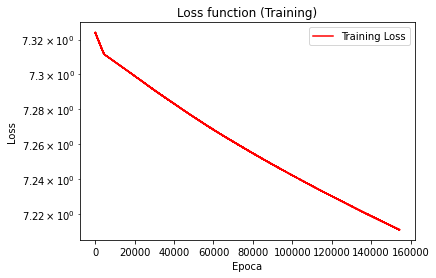

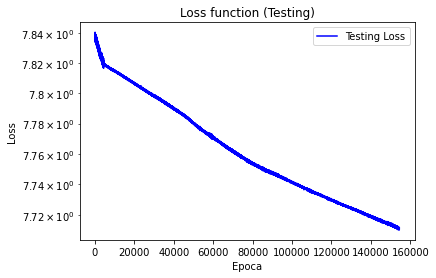

In [ ]:
modello_sperimentale.allena(learning_rate=3*1e-4,momentum=.9,epochs=50000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin\{table}[]
\begin\{tabular}\{ll}
Modello & [[8, 4, 1], 'SiLU'] \\
Errore medio (training set) & 7.21cm \\
Errori maggiori di 5cm (training set) & 54.72\% dei casi\\
Errori maggiori di 10cm (training set) & 27.21\% dei casi\\
Errore relativo medio (training set) & 6.13\% \\
Errori relativi maggiori del 10\% (training set) & 15.8\% dei casi \\
Errore medio a 50cm (training set): & 8.313cm (10.392\%)\\
Errore medio a 80cm (training set): & 2.824cm (3.53\%)\\
Errore medio a 100cm (training set): & 7.641cm (9.551\%)\\
Errore medio a 120cm (training set): & 8.51cm (10.638\%)\\
Errore medio a 150cm (training set): & 7.705cm (9.631\%)\\
Errore medio a 170cm (training set): & 7.034cm (8.792\%)\\
Errore medio a 200cm (training set): & 6.334cm (7.917\%)\\
Errore medio a 220cm (training set): & 6.903cm (8.629\%)\\
Errore medio a 250cm (training set): & 9.23cm (11.538\%)\\
Errore medio (testing set) & 7.71cm \\
Errori maggiori di 5cm (testing set) & 54.73\% dei casi\\
Errori maggiori di 10cm 

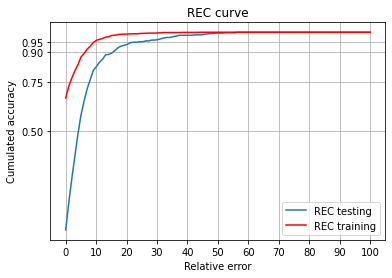

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 2:
Rete con un hidden layer e 4 hidden units usando la LeakyReLU come funzione di attivazione

In [ ]:
modello_sperimentale=distanzinator(architecture=[8,4,1],activation_function=nn.LeakyReLU)

Streaming output truncated to the last 5000 lines.
Epoch  1 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  10.32010555267334 	 Testing Loss:  10.871315002441406
Epoch  2 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  10.319119453430176 	 Testing Loss:  10.873156547546387
Epoch  3 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  10.317187309265137 	 Testing Loss:  10.87264347076416
Epoch  4 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  10.31449031829834 	 Testing Loss:  10.86851692199707
Epoch  5 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  10.3110990524292 	 Testing Loss:  10.871052742004395
Epoch  6 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  10.307079315185547 	 Testing Loss:  10.864191055297852
Epoch  7 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  10.302398681640625 	 Testing Loss:  10.862388610839844
Epoch  8 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training L

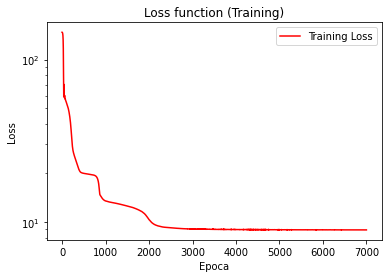

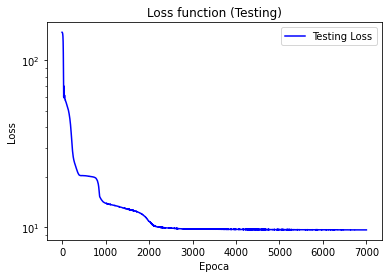

In [ ]:
modello_sperimentale.allena(learning_rate=1e-2,momentum=.9,epochs=5000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

Errore medio:  9.66 cm\
Errore maggiore di 5 cm in 310/455 casi(68.13\%)\\
Errore maggiore di 10 cm in 188/455 casi(41.32\%)\\
Errore relativo medio: 8.06\%)\\
Errore relativo maggiore del 10% in 117/455 casi (25.71 \%)\\
Errore medio a 50 cm:	10.269	 cm (20.537\%)\\
Errore medio a 80 cm:	5.685	 cm (7.107\%)\\
Errore medio a 100 cm:	5.597	 cm (5.597\%)\\
Errore medio a 120 cm:	12.036	 cm (10.03\%)\\
Errore medio a 150 cm:	13.289	 cm (8.859\%)\\
Errore medio a 170 cm:	10.218	 cm (6.011\%)\\
Errore medio a 200 cm:	10.5	 cm (5.25\%)\\
Errore medio a 220 cm:	8.135	 cm (3.698\%)\\
Errore medio a 250 cm:	11.466	 cm (4.586\%)\\


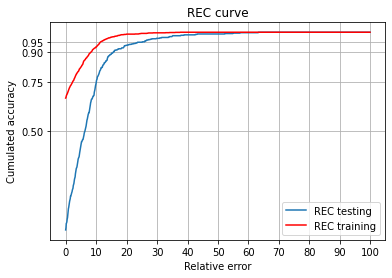

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 3:
Un hidden layer con 8 hidden units
SiLU

In [ ]:
modello_sperimentale=distanzinator(architecture=[8,8,1])

Streaming output truncated to the last 5000 lines.
Epoch  5001 / 10000 	   Tempo trascorso:  0.64 	 Eta:  0.64 	 Training Loss:  5.215216159820557 	 Testing Loss:  5.740660190582275
Epoch  5002 / 10000 	   Tempo trascorso:  0.64 	 Eta:  0.64 	 Training Loss:  5.215222358703613 	 Testing Loss:  5.741186141967773
Epoch  5003 / 10000 	   Tempo trascorso:  0.64 	 Eta:  0.639 	 Training Loss:  5.215068340301514 	 Testing Loss:  5.741359233856201
Epoch  5004 / 10000 	   Tempo trascorso:  0.64 	 Eta:  0.639 	 Training Loss:  5.215064525604248 	 Testing Loss:  5.739636421203613
Epoch  5005 / 10000 	   Tempo trascorso:  0.64 	 Eta:  0.639 	 Training Loss:  5.215893745422363 	 Testing Loss:  5.742398262023926
Epoch  5006 / 10000 	   Tempo trascorso:  0.641 	 Eta:  0.64 	 Training Loss:  5.215933322906494 	 Testing Loss:  5.739830017089844
Epoch  5007 / 10000 	   Tempo trascorso:  0.641 	 Eta:  0.639 	 Training Loss:  5.216277122497559 	 Testing Loss:  5.7420125007629395
Epoch  5008 / 10000 	   T

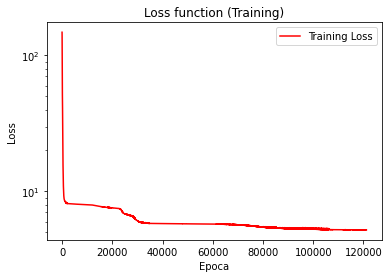

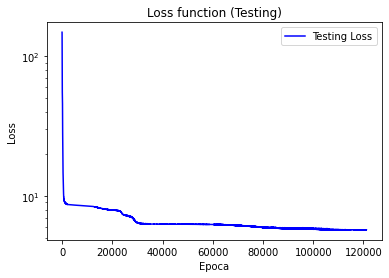

In [ ]:
modello_sperimentale.allena(learning_rate=1e-3,momentum=.9,epochs=10000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin\{tabular}{ll}
Modello & [[8, 8, 1], 'SiLU'] \\
Errore medio (training set) & 5.21cm \\
Errori maggiori di 5cm (training set) & 41.62\% dei casi\\
Errori maggiori di 10cm (training set) & 14.12\% dei casi\\
Errore relativo medio (training set) & 4.34\% \\
Errori relativi maggiori del 10\% (training set) & 10.9\% dei casi \\
Errore medio a 50cm (training set): & 3.435cm (4.293\%)\\
Errore medio a 80cm (training set): & 4.903cm (6.129\%)\\
Errore medio a 100cm (training set): & 7.11cm (8.888\%)\\
Errore medio a 120cm (training set): & 6.358cm (7.948\%)\\
Errore medio a 150cm (training set): & 7.443cm (9.304\%)\\
Errore medio a 170cm (training set): & 2.728cm (3.41\%)\\
Errore medio a 200cm (training set): & 5.153cm (6.442\%)\\
Errore medio a 220cm (training set): & 5.397cm (6.746\%)\\
Errore medio a 250cm (training set): & 4.155cm (5.193\%)\\
Errore medio (testing set) & 5.73cm \\
Errori maggiori di 5cm (testing set) & 45.71\% dei casi\\
Errori maggiori di 10cm (tes

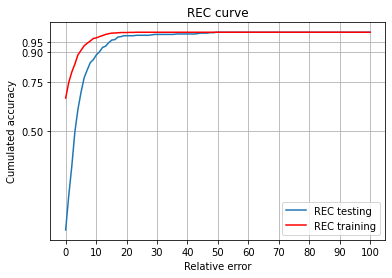

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 4
un hidden layer con 16 hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[8,16,1])

Streaming output truncated to the last 5000 lines.
Epoch  95001 / 100000 	   Tempo trascorso:  11.692 	 Eta:  0.615 	 Training Loss:  4.448843479156494 	 Testing Loss:  4.867979049682617
Epoch  95002 / 100000 	   Tempo trascorso:  11.692 	 Eta:  0.615 	 Training Loss:  4.449242115020752 	 Testing Loss:  4.868680477142334
Epoch  95003 / 100000 	   Tempo trascorso:  11.692 	 Eta:  0.615 	 Training Loss:  4.449588298797607 	 Testing Loss:  4.867980003356934
Epoch  95004 / 100000 	   Tempo trascorso:  11.692 	 Eta:  0.615 	 Training Loss:  4.449463367462158 	 Testing Loss:  4.868124485015869
Epoch  95005 / 100000 	   Tempo trascorso:  11.692 	 Eta:  0.615 	 Training Loss:  4.448824405670166 	 Testing Loss:  4.868424415588379
Epoch  95006 / 100000 	   Tempo trascorso:  11.692 	 Eta:  0.615 	 Training Loss:  4.449174404144287 	 Testing Loss:  4.868017196655273
Epoch  95007 / 100000 	   Tempo trascorso:  11.692 	 Eta:  0.615 	 Training Loss:  4.44928503036499 	 Testing Loss:  4.86833906173706

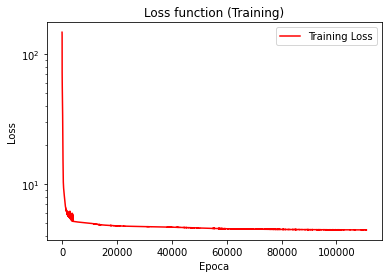

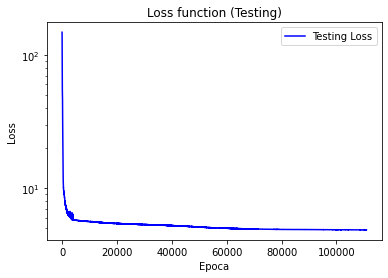

In [ ]:
modello_sperimentale.allena(learning_rate=3*1e-3,momentum=.9,epochs=100000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[8, 16, 1], 'SiLU'] \\
Errore medio (training set) & 4.44cm \\
Errori maggiori di 5cm (training set) & 32.26\% dei casi\\
Errori maggiori di 10cm (training set) & 10.83\% dei casi\\
Errore relativo medio (training set) & 3.49\% \\
Errori relativi maggiori del 10\% (training set) & 6.88\% dei casi \\
Errore medio a 50cm (training set): & 1.681cm (3.362\%)\\
Errore medio a 80cm (training set): & 3.177cm (3.971\%)\\
Errore medio a 100cm (training set): & 7.937cm (7.937\%)\\
Errore medio a 120cm (training set): & 5.151cm (4.292\%)\\
Errore medio a 150cm (training set): & 5.571cm (3.714\%)\\
Errore medio a 170cm (training set): & 2.375cm (1.397\%)\\
Errore medio a 200cm (training set): & 4.128cm (2.064\%)\\
Errore medio a 220cm (training set): & 6.341cm (2.882\%)\\
Errore medio a 250cm (training set): & 3.409cm (1.364\%)\\
Errore medio (testing set) & 4.86cm \\
Errori maggiori di 5cm (testing set) & 37.8\% dei casi\\
Errori maggiori di 10cm (te

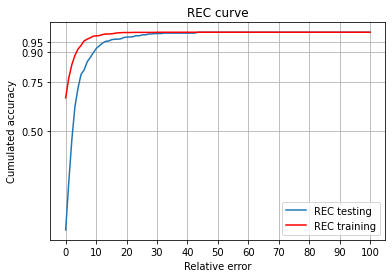

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 4B
DUE HIDDEN LAYER CON [4,4] HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[8,4,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  45001 / 50000 	   Tempo trascorso:  5.938 	 Eta:  0.66 	 Training Loss:  4.983511447906494 	 Testing Loss:  5.471833229064941
Epoch  45002 / 50000 	   Tempo trascorso:  5.938 	 Eta:  0.66 	 Training Loss:  4.98362922668457 	 Testing Loss:  5.471160411834717
Epoch  45003 / 50000 	   Tempo trascorso:  5.938 	 Eta:  0.659 	 Training Loss:  4.983519554138184 	 Testing Loss:  5.470004081726074
Epoch  45004 / 50000 	   Tempo trascorso:  5.938 	 Eta:  0.659 	 Training Loss:  4.983508586883545 	 Testing Loss:  5.469616889953613
Epoch  45005 / 50000 	   Tempo trascorso:  5.938 	 Eta:  0.659 	 Training Loss:  4.983564376831055 	 Testing Loss:  5.47102165222168
Epoch  45006 / 50000 	   Tempo trascorso:  5.938 	 Eta:  0.659 	 Training Loss:  4.983480930328369 	 Testing Loss:  5.4717698097229
Epoch  45007 / 50000 	   Tempo trascorso:  5.938 	 Eta:  0.659 	 Training Loss:  4.983589172363281 	 Testing Loss:  5.470542907714844
Epoch  45008 / 50

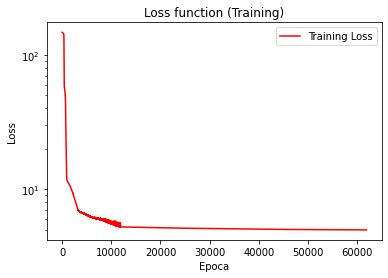

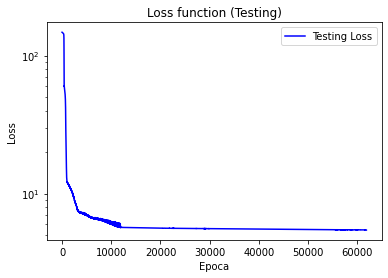

In [ ]:
modello_sperimentale.allena(learning_rate=1e-4,momentum=.9,epochs=50000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[8, 4, 4, 1], 'SiLU'] \\
Errore medio (training set) & 4.97cm \\
Errori maggiori di 5cm (training set) & 38.92\% dei casi\\
Errori maggiori di 10cm (training set) & 13.83\% dei casi\\
Errore relativo medio (training set) & 3.91\% \\
Errori relativi maggiori del 10\% (training set) & 7.97\% dei casi \\
Errore medio a 50cm (training set): & 1.999cm (2.498\%)\\
Errore medio a 80cm (training set): & 4.03cm (5.037\%)\\
Errore medio a 100cm (training set): & 8.614cm (10.767\%)\\
Errore medio a 120cm (training set): & 5.1cm (6.375\%)\\
Errore medio a 150cm (training set): & 5.838cm (7.298\%)\\
Errore medio a 170cm (training set): & 3.121cm (3.901\%)\\
Errore medio a 200cm (training set): & 4.598cm (5.747\%)\\
Errore medio a 220cm (training set): & 6.265cm (7.831\%)\\
Errore medio a 250cm (training set): & 4.979cm (6.224\%)\\
Errore medio (testing set) & 5.46cm \\
Errori maggiori di 5cm (testing set) & 41.32\% dei casi\\
Errori maggiori di 10cm (t

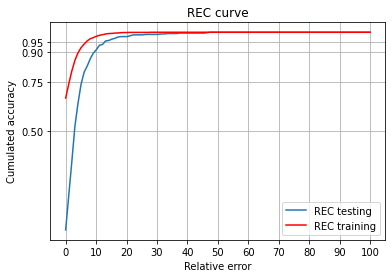

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 5
DUE HIDDEN LAYER CON [8,4] HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[8,8,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  95001 / 100000 	   Tempo trascorso:  9.787 	 Eta:  0.515 	 Training Loss:  4.806586265563965 	 Testing Loss:  5.3448686599731445
Epoch  95002 / 100000 	   Tempo trascorso:  9.787 	 Eta:  0.515 	 Training Loss:  4.806562900543213 	 Testing Loss:  5.346859931945801
Epoch  95003 / 100000 	   Tempo trascorso:  9.787 	 Eta:  0.515 	 Training Loss:  4.806421279907227 	 Testing Loss:  5.347066402435303
Epoch  95004 / 100000 	   Tempo trascorso:  9.787 	 Eta:  0.515 	 Training Loss:  4.806427001953125 	 Testing Loss:  5.3440093994140625
Epoch  95005 / 100000 	   Tempo trascorso:  9.787 	 Eta:  0.515 	 Training Loss:  4.806787490844727 	 Testing Loss:  5.349052429199219
Epoch  95006 / 100000 	   Tempo trascorso:  9.787 	 Eta:  0.515 	 Training Loss:  4.806992530822754 	 Testing Loss:  5.346245288848877
Epoch  95007 / 100000 	   Tempo trascorso:  9.787 	 Eta:  0.514 	 Training Loss:  4.806347370147705 	 Testing Loss:  5.343810081481934
Ep

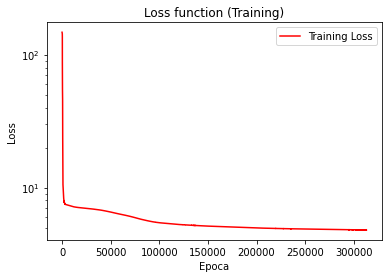

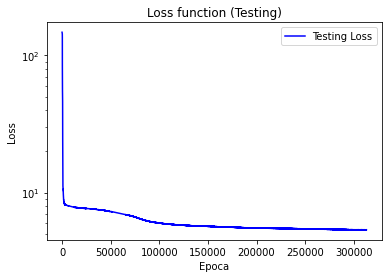

In [ ]:
modello_sperimentale.allena(learning_rate=1e-4,momentum=.9,epochs=100000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin\{table}[]
\begin\{tabular}\{ll}
Modello & [[8, 8, 4, 1], 'SiLU'] \\
Errore medio (training set) & 4.8cm \\
Errori maggiori di 5cm (training set) & 37.31\% dei casi\\
Errori maggiori di 10cm (training set) & 12.14\% dei casi\\
Errore relativo medio (training set) & 3.81cm \\
Errori relativi maggiori del 10\% (training set) & 7.39\% dei casi \\
Errore medio a 50cm (training set): & 2.093cm (2.616\%)\\
Errore medio a 80cm (training set): & 3.821cm (4.776\%)\\
Errore medio a 100cm (training set): & 8.503cm (10.629\%)\\
Errore medio a 120cm (training set): & 4.954cm (6.192\%)\\
Errore medio a 150cm (training set): & 5.597cm (6.996\%)\\
Errore medio a 170cm (training set): & 2.676cm (3.345\%)\\
Errore medio a 200cm (training set): & 4.343cm (5.429\%)\\
Errore medio a 220cm (training set): & 6.65cm (8.313\%)\\
Errore medio a 250cm (training set): & 4.357cm (5.447\%)\\
Errore medio (testing set) & 1.78cm \\
Errori maggiori di 5cm (testing set) & 14.41\% dei casi\\
Errori maggiori di 10c

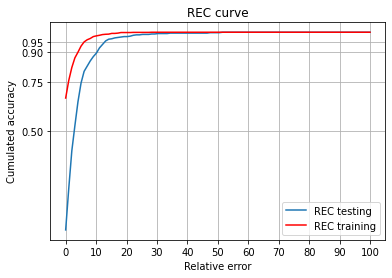

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

##4 PUNTI + AREA IN INPUT

###CARICO IL DATASET

In [ ]:
pos=[0,1,2,3,4,5,6,7,16]
dataset_x=[]
for elemento in preprocessed_dataset_x:
  temp=torch.Tensor([elemento[y] for y in pos])
  dataset_x.append(torch.reshape(temp,(-1,)))

dataset_x=torch.stack(dataset_x)
dataset_y=preprocessed_dataset_y

#Shuffle the dataset
dataset_x, dataset_y = shuffle(dataset_x, dataset_y, random_state=seed_randoom)

dataset_size=len(dataset_x)

testing_size=int(dataset_size/4.)

#Separo in training e testing
training_x=dataset_x[testing_size:]
training_y=dataset_y[testing_size:]
testing_x=dataset_x[:testing_size]
testing_y=dataset_y[:testing_size]

###ESPERIMENTO 1:
un hidden layer con4 hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[9,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  45001 / 50000 	   Tempo trascorso:  5.623 	 Eta:  0.625 	 Training Loss:  6.884322643280029 	 Testing Loss:  7.685360908508301
Epoch  45002 / 50000 	   Tempo trascorso:  5.623 	 Eta:  0.625 	 Training Loss:  6.884341239929199 	 Testing Loss:  7.685285568237305
Epoch  45003 / 50000 	   Tempo trascorso:  5.623 	 Eta:  0.624 	 Training Loss:  6.884329795837402 	 Testing Loss:  7.6854681968688965
Epoch  45004 / 50000 	   Tempo trascorso:  5.623 	 Eta:  0.624 	 Training Loss:  6.884319305419922 	 Testing Loss:  7.685036659240723
Epoch  45005 / 50000 	   Tempo trascorso:  5.623 	 Eta:  0.624 	 Training Loss:  6.88435697555542 	 Testing Loss:  7.685554504394531
Epoch  45006 / 50000 	   Tempo trascorso:  5.624 	 Eta:  0.624 	 Training Loss:  6.884344100952148 	 Testing Loss:  7.68552303314209
Epoch  45007 / 50000 	   Tempo trascorso:  5.624 	 Eta:  0.624 	 Training Loss:  6.884328365325928 	 Testing Loss:  7.68562650680542
Epoch  45008 

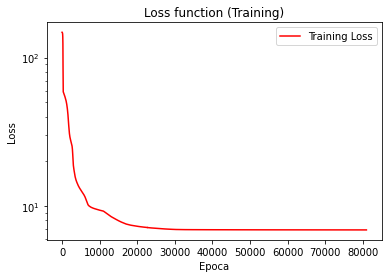

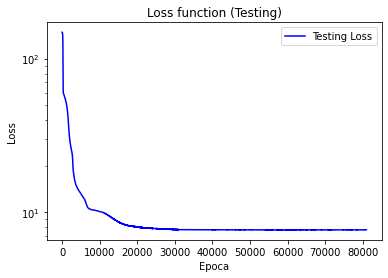

In [ ]:
modello_sperimentale.allena(learning_rate=1e-3,momentum=.9,epochs=50000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[9, 4, 1], 'SiLU'] \\
Errore medio (training set) & 6.88cm \\
Errori maggiori di 5cm (training set) & 53.77\% dei casi\\
Errori maggiori di 10cm (training set) & 25.9\% dei casi\\
Errore relativo medio (training set) & 4.95\% \\
Errori relativi maggiori del 10\% (training set) & 11.63\% dei casi \\
Errore medio a 50cm (training set): & 1.365cm (1.707\%)\\
Errore medio a 80cm (training set): & 5.386cm (6.733\%)\\
Errore medio a 100cm (training set): & 8.723cm (10.903\%)\\
Errore medio a 120cm (training set): & 5.867cm (7.334\%)\\
Errore medio a 150cm (training set): & 9.78cm (12.225\%)\\
Errore medio a 170cm (training set): & 6.554cm (8.192\%)\\
Errore medio a 200cm (training set): & 7.204cm (9.005\%)\\
Errore medio a 220cm (training set): & 8.887cm (11.109\%)\\
Errore medio a 250cm (training set): & 8.305cm (10.381\%)\\
Errore medio (testing set) & 7.69cm \\
Errori maggiori di 5cm (testing set) & 57.8\% dei casi\\
Errori maggiori di 10cm (

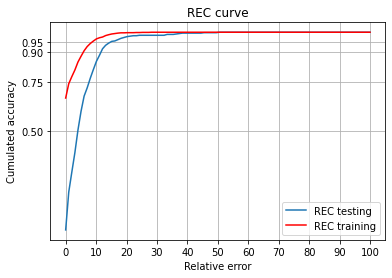

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 2:
un hidden layer con 8 hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[9,8,1])

Streaming output truncated to the last 5000 lines.
Epoch  45001 / 50000 	   Tempo trascorso:  5.588 	 Eta:  0.621 	 Training Loss:  5.247439861297607 	 Testing Loss:  5.917560577392578
Epoch  45002 / 50000 	   Tempo trascorso:  5.588 	 Eta:  0.621 	 Training Loss:  5.246102809906006 	 Testing Loss:  5.91843843460083
Epoch  45003 / 50000 	   Tempo trascorso:  5.588 	 Eta:  0.621 	 Training Loss:  5.246302127838135 	 Testing Loss:  5.909700870513916
Epoch  45004 / 50000 	   Tempo trascorso:  5.588 	 Eta:  0.62 	 Training Loss:  5.248456954956055 	 Testing Loss:  5.920000076293945
Epoch  45005 / 50000 	   Tempo trascorso:  5.588 	 Eta:  0.62 	 Training Loss:  5.246622085571289 	 Testing Loss:  5.915045738220215
Epoch  45006 / 50000 	   Tempo trascorso:  5.588 	 Eta:  0.62 	 Training Loss:  5.245543003082275 	 Testing Loss:  5.911077499389648
Epoch  45007 / 50000 	   Tempo trascorso:  5.588 	 Eta:  0.62 	 Training Loss:  5.247565746307373 	 Testing Loss:  5.926049709320068
Epoch  45008 / 5

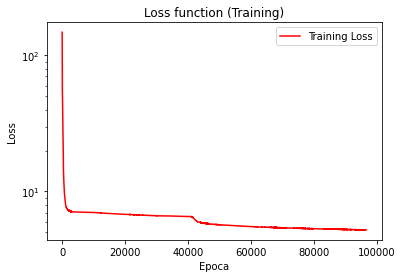

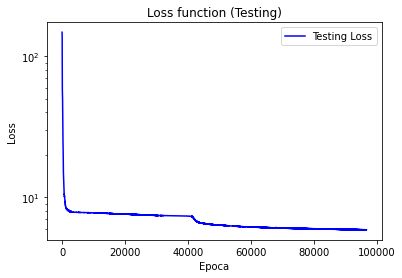

In [ ]:
modello_sperimentale.allena(learning_rate=3*1e-3,momentum=.9,epochs=50000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[9, 8, 1], 'SiLU'] \\
Errore medio (training set) & 5.22cm \\
Errori maggiori di 5cm (training set) & 41.99\% dei casi\\
Errori maggiori di 10cm (training set) & 14.85\% dei casi\\
Errore relativo medio (training set) & 4.05\% \\
Errori relativi maggiori del 10\% (training set) & 8.56\% dei casi \\
Errore medio a 50cm (training set): & 1.875cm (2.344\%)\\
Errore medio a 80cm (training set): & 4.37cm (5.463\%)\\
Errore medio a 100cm (training set): & 8.909cm (11.136\%)\\
Errore medio a 120cm (training set): & 4.513cm (5.642\%)\\
Errore medio a 150cm (training set): & 6.824cm (8.529\%)\\
Errore medio a 170cm (training set): & 3.396cm (4.245\%)\\
Errore medio a 200cm (training set): & 5.638cm (7.048\%)\\
Errore medio a 220cm (training set): & 6.568cm (8.21\%)\\
Errore medio a 250cm (training set): & 4.751cm (5.938\%)\\
Errore medio (testing set) & 5.88cm \\
Errori maggiori di 5cm (testing set) & 45.71\% dei casi\\
Errori maggiori di 10cm (tes

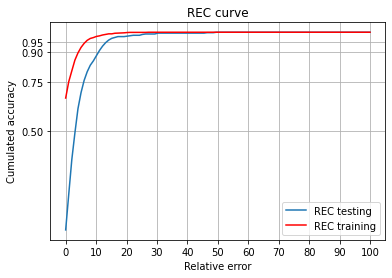

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 2B
UN HIDDEN LAYER CON 16 HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[9,16,1])

Epoch  1 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.513391494750977 	 Testing Loss:  4.995622634887695
Epoch  2 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.513718605041504 	 Testing Loss:  4.993895053863525
Epoch  3 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.513487815856934 	 Testing Loss:  4.994484901428223
Epoch  4 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.513346195220947 	 Testing Loss:  4.995109558105469
Epoch  5 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.199 	 Training Loss:  4.513462543487549 	 Testing Loss:  4.9936652183532715
Epoch  6 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.166 	 Training Loss:  4.513698101043701 	 Testing Loss:  4.995604991912842
Epoch  7 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.142 	 Training Loss:  4.513575553894043 	 Testing Loss:  4.994782447814941
Epoch  8 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.124 	 Training Loss:  4.513351917266846 	 Testing Loss:  4

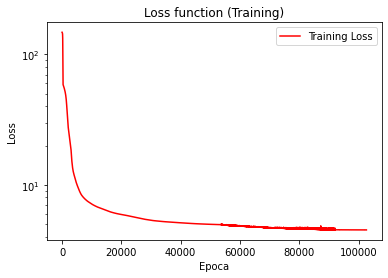

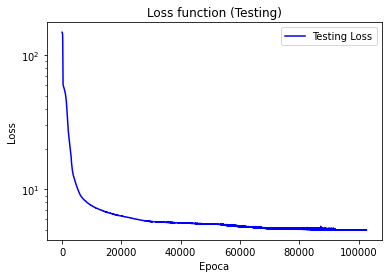

In [ ]:
modello_sperimentale.allena(learning_rate=1e-3,momentum=.9,epochs=1000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[9, 16, 1], 'SiLU'] \\
Errore medio (training set) & 4.51cm \\
Errori maggiori di 5cm (training set) & 34.82\% dei casi\\
Errori maggiori di 10cm (training set) & 11.05\% dei casi\\
Errore relativo medio (training set) & 3.56\% \\
Errori relativi maggiori del 10\% (training set) & 7.24\% dei casi \\
Errore medio a 50cm (training set): & 1.502cm (3.005\%)\\
Errore medio a 80cm (training set): & 3.879cm (4.849\%)\\
Errore medio a 100cm (training set): & 8.417cm (8.417\%)\\
Errore medio a 120cm (training set): & 4.43cm (3.691\%)\\
Errore medio a 150cm (training set): & 6.02cm (4.014\%)\\
Errore medio a 170cm (training set): & 2.412cm (1.419\%)\\
Errore medio a 200cm (training set): & 4.41cm (2.205\%)\\
Errore medio a 220cm (training set): & 5.886cm (2.676\%)\\
Errore medio a 250cm (training set): & 3.47cm (1.388\%)\\
Errore medio (testing set) & 4.99cm \\
Errori maggiori di 5cm (testing set) & 36.92\% dei casi\\
Errori maggiori di 10cm (testi

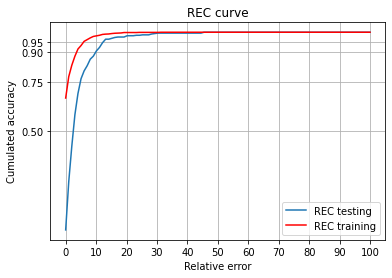

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 3
due hidden layer [4,4] hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[9,4,4,1])

Epoch  1 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.794236660003662 	 Testing Loss:  5.2081403732299805
Epoch  2 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.79417610168457 	 Testing Loss:  5.207878589630127
Epoch  3 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.794261932373047 	 Testing Loss:  5.205388069152832
Epoch  4 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.79665994644165 	 Testing Loss:  5.218895435333252
Epoch  5 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.801367282867432 	 Testing Loss:  5.209120750427246
Epoch  6 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.7944841384887695 	 Testing Loss:  5.202981948852539
Epoch  7 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.142 	 Training Loss:  4.810048580169678 	 Testing Loss:  5.220303535461426
Epoch  8 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.124 	 Training Loss:  4.80133581161499 	 Testing Loss:  5.220376491

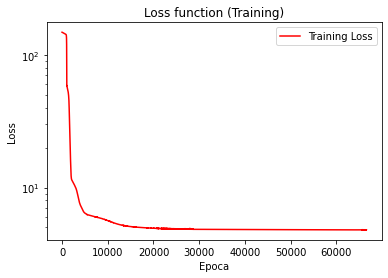

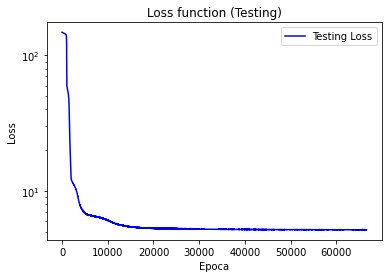

In [ ]:
modello_sperimentale.allena(learning_rate=3*1e-4,momentum=.9,epochs=1000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[9, 4, 4, 1], 'SiLU'] \\
Errore medio (training set) & 4.79cm \\
Errori maggiori di 5cm (training set) & 37.31\% dei casi\\
Errori maggiori di 10cm (training set) & 12.73\% dei casi\\
Errore relativo medio (training set) & 3.87\% \\
Errori relativi maggiori del 10\% (training set) & 8.12\% dei casi \\
Errore medio a 50cm (training set): & 2.469cm (3.087\%)\\
Errore medio a 80cm (training set): & 3.914cm (4.892\%)\\
Errore medio a 100cm (training set): & 8.23cm (10.287\%)\\
Errore medio a 120cm (training set): & 5.147cm (6.434\%)\\
Errore medio a 150cm (training set): & 5.75cm (7.187\%)\\
Errore medio a 170cm (training set): & 2.527cm (3.158\%)\\
Errore medio a 200cm (training set): & 4.38cm (5.475\%)\\
Errore medio a 220cm (training set): & 6.276cm (7.845\%)\\
Errore medio a 250cm (training set): & 4.197cm (5.247\%)\\
Errore medio (testing set) & 5.2cm \\
Errori maggiori di 5cm (testing set) & 40.44\% dei casi\\
Errori maggiori di 10cm (te

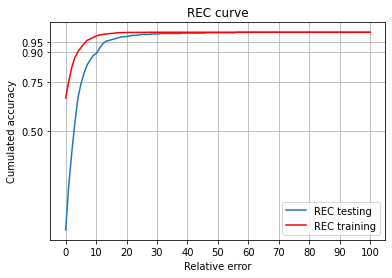

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 4
due hidden layer [8,4] hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[9,8,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  5001 / 10000 	   Tempo trascorso:  0.673 	 Eta:  0.673 	 Training Loss:  4.971948146820068 	 Testing Loss:  5.523584365844727
Epoch  5002 / 10000 	   Tempo trascorso:  0.673 	 Eta:  0.673 	 Training Loss:  4.971922397613525 	 Testing Loss:  5.523501873016357
Epoch  5003 / 10000 	   Tempo trascorso:  0.673 	 Eta:  0.672 	 Training Loss:  4.971920013427734 	 Testing Loss:  5.524534225463867
Epoch  5004 / 10000 	   Tempo trascorso:  0.673 	 Eta:  0.672 	 Training Loss:  4.97191047668457 	 Testing Loss:  5.523505687713623
Epoch  5005 / 10000 	   Tempo trascorso:  0.673 	 Eta:  0.672 	 Training Loss:  4.971896648406982 	 Testing Loss:  5.523196220397949
Epoch  5006 / 10000 	   Tempo trascorso:  0.673 	 Eta:  0.672 	 Training Loss:  4.971902370452881 	 Testing Loss:  5.523961067199707
Epoch  5007 / 10000 	   Tempo trascorso:  0.673 	 Eta:  0.671 	 Training Loss:  4.971895217895508 	 Testing Loss:  5.52386474609375
Epoch  5008 / 10000 

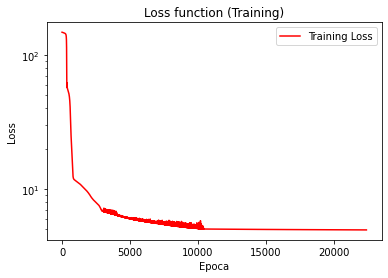

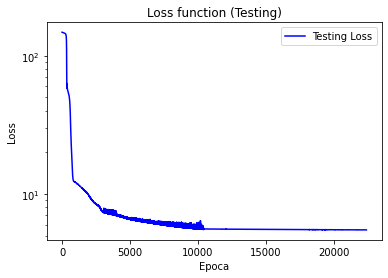

In [ ]:
modello_sperimentale.allena(learning_rate=1e-4,momentum=.9,epochs=10000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

Statistiche sul training set:\\
Errore medio:  4.95 cm\\
Errore maggiore di 5 cm in 537/1367 casi(39.28\%)\\
Errore maggiore di 10 cm in 187/1367 casi(13.68\%)\\
Errore relativo medio: 3.9\%)\\
Errore relativo maggiore del 10% in 112/1367 casi (8.19 \%)\\
Errore medio a 50 cm:	 2.302	 cm (2.877\%)\\
Errore medio a 80 cm:	 3.709	 cm (4.637\%)\\
Errore medio a 100 cm:	 8.096	 cm (10.121\%)\\
Errore medio a 120 cm:	 5.3	 cm (6.625\%)\\
Errore medio a 150 cm:	 5.891	 cm (7.363\%)\\
Errore medio a 170 cm:	 3.135	 cm (3.918\%)\\
Errore medio a 200 cm:	 4.724	 cm (5.905\%)\\
Errore medio a 220 cm:	 6.202	 cm (7.752\%)\\
Errore medio a 250 cm:	 4.952	 cm (6.19\%)\\
Statistiche sul testing set:\\
Errore medio:  5.49 cm\\
Errore maggiore di 5 cm in 189/455 casi(41.54\%)\\
Errore maggiore di 10 cm in 71/455 casi(15.6\%)\\
Errore relativo medio: 4.45\%)\\
Errore relativo maggiore del 10% in 44/455 casi (9.67 \%)\\
Errore medio a 50 cm:	 3.773	 cm (4.716\%)\\
Errore medio a 80 cm:	 3.677	 cm (4.597

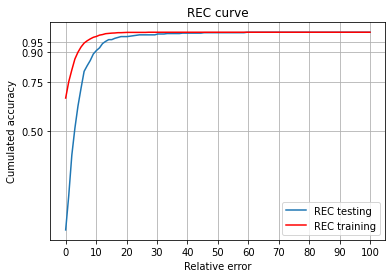

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

##8 PUNTI IN INPUT

###CARICO IL DATASET

In [ ]:
pos=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]
dataset_x=[]
for elemento in preprocessed_dataset_x:
  temp=torch.Tensor([elemento[y] for y in pos])
  dataset_x.append(torch.reshape(temp,(-1,)))

dataset_x=torch.stack(dataset_x)
dataset_y=preprocessed_dataset_y

#Shuffle the dataset
dataset_x, dataset_y = shuffle(dataset_x, dataset_y, random_state=seed_randoom)

dataset_size=len(dataset_x)

testing_size=int(dataset_size/4.)

#Separo in training e testing
training_x=dataset_x[testing_size:]
training_y=dataset_y[testing_size:]
testing_x=dataset_x[:testing_size]
testing_y=dataset_y[:testing_size]

###ESPERIMENTO 0
un hidden layer con 4 hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[16,4,1])

Epoch  1 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  6.35643196105957 	 Testing Loss:  7.297877788543701
Epoch  2 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  6.356886863708496 	 Testing Loss:  7.295170307159424
Epoch  3 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  6.357563495635986 	 Testing Loss:  7.290434837341309
Epoch  4 / 1000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  6.354630947113037 	 Testing Loss:  7.29595422744751
Epoch  5 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.199 	 Training Loss:  6.3561601638793945 	 Testing Loss:  7.30128288269043
Epoch  6 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.166 	 Training Loss:  6.354740142822266 	 Testing Loss:  7.30305290222168
Epoch  7 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.142 	 Training Loss:  6.354374408721924 	 Testing Loss:  7.299522876739502
Epoch  8 / 1000 	   Tempo trascorso:  0.001 	 Eta:  0.124 	 Training Loss:  6.356451511383057 	 Testing Loss:  7.292

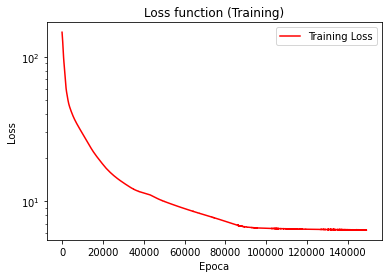

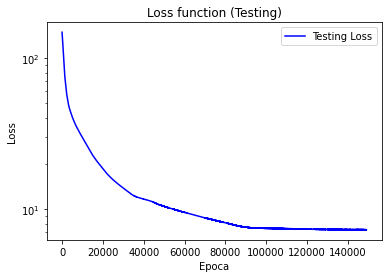

In [ ]:
modello_sperimentale.allena(learning_rate=5*1e-3,momentum=.9,epochs=1000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[16, 4, 1], 'SiLU'] \\
Errore medio (training set) & 6.35cm \\
Errori maggiori di 5cm (training set) & 46.67\% dei casi\\
Errori maggiori di 10cm (training set) & 21.65\% dei casi\\
Errore relativo medio (training set) & 4.97\% \\
Errori relativi maggiori del 10\% (training set) & 11.41\% dei casi \\
Errore medio a 50cm (training set): & 3.242cm (4.053\%)\\
Errore medio a 80cm (training set): & 4.534cm (5.667\%)\\
Errore medio a 100cm (training set): & 9.231cm (11.539\%)\\
Errore medio a 120cm (training set): & 6.161cm (7.701\%)\\
Errore medio a 150cm (training set): & 7.093cm (8.867\%)\\
Errore medio a 170cm (training set): & 5.438cm (6.797\%)\\
Errore medio a 200cm (training set): & 7.358cm (9.197\%)\\
Errore medio a 220cm (training set): & 10.068cm (12.586\%)\\
Errore medio a 250cm (training set): & 4.01cm (5.013\%)\\
Errore medio (testing set) & 7.3cm \\
Errori maggiori di 5cm (testing set) & 50.11\% dei casi\\
Errori maggiori di 10cm 

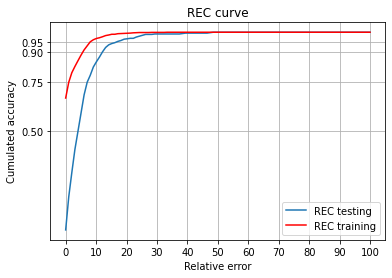

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 1:
Un hidden layer con 8 hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[16,8,1])

Streaming output truncated to the last 5000 lines.
Epoch  5001 / 10000 	   Tempo trascorso:  0.642 	 Eta:  0.642 	 Training Loss:  5.032153129577637 	 Testing Loss:  5.618259906768799
Epoch  5002 / 10000 	   Tempo trascorso:  0.642 	 Eta:  0.642 	 Training Loss:  5.032149314880371 	 Testing Loss:  5.618618011474609
Epoch  5003 / 10000 	   Tempo trascorso:  0.642 	 Eta:  0.641 	 Training Loss:  5.03213357925415 	 Testing Loss:  5.618625640869141
Epoch  5004 / 10000 	   Tempo trascorso:  0.642 	 Eta:  0.641 	 Training Loss:  5.032131195068359 	 Testing Loss:  5.618846416473389
Epoch  5005 / 10000 	   Tempo trascorso:  0.642 	 Eta:  0.641 	 Training Loss:  5.03215217590332 	 Testing Loss:  5.6184234619140625
Epoch  5006 / 10000 	   Tempo trascorso:  0.642 	 Eta:  0.641 	 Training Loss:  5.032171726226807 	 Testing Loss:  5.618648529052734
Epoch  5007 / 10000 	   Tempo trascorso:  0.642 	 Eta:  0.64 	 Training Loss:  5.032123565673828 	 Testing Loss:  5.6194987297058105
Epoch  5008 / 10000

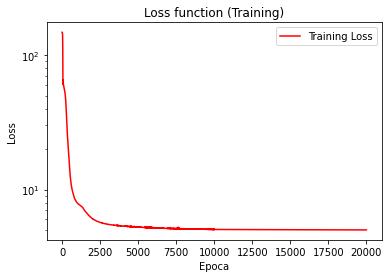

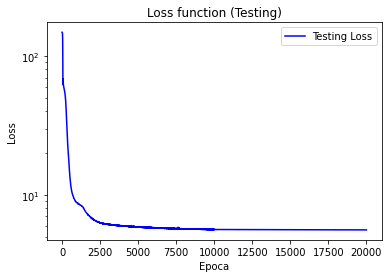

In [ ]:
modello_sperimentale.allena(learning_rate=1e-3,momentum=.9,epochs=10000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[16, 8, 1], 'SiLU'] \\
Errore medio (training set) & 5.02cm \\
Errori maggiori di 5cm (training set) & 38.26\% dei casi\\
Errori maggiori di 10cm (training set) & 12.73\% dei casi\\
Errore relativo medio (training set) & 4.57\% \\
Errori relativi maggiori del 10\% (training set) & 10.75\% dei casi \\
Errore medio a 50cm (training set): & 6.198cm (7.747\%)\\
Errore medio a 80cm (training set): & 2.828cm (3.535\%)\\
Errore medio a 100cm (training set): & 8.353cm (10.442\%)\\
Errore medio a 120cm (training set): & 5.609cm (7.012\%)\\
Errore medio a 150cm (training set): & 5.232cm (6.541\%)\\
Errore medio a 170cm (training set): & 2.225cm (2.782\%)\\
Errore medio a 200cm (training set): & 4.977cm (6.222\%)\\
Errore medio a 220cm (training set): & 5.419cm (6.774\%)\\
Errore medio a 250cm (training set): & 3.795cm (4.743\%)\\
Errore medio (testing set) & 5.6cm \\
Errori maggiori di 5cm (testing set) & 41.98\% dei casi\\
Errori maggiori di 10cm (

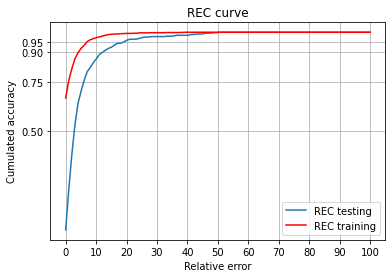

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 1B
UN HIDDEN LAYER CON 16 HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[16,16,1])

Streaming output truncated to the last 5000 lines.
Epoch  5001 / 10000 	   Tempo trascorso:  0.579 	 Eta:  0.579 	 Training Loss:  4.272365093231201 	 Testing Loss:  4.668928623199463
Epoch  5002 / 10000 	   Tempo trascorso:  0.579 	 Eta:  0.579 	 Training Loss:  4.272245407104492 	 Testing Loss:  4.668900966644287
Epoch  5003 / 10000 	   Tempo trascorso:  0.579 	 Eta:  0.578 	 Training Loss:  4.272256851196289 	 Testing Loss:  4.669543266296387
Epoch  5004 / 10000 	   Tempo trascorso:  0.579 	 Eta:  0.578 	 Training Loss:  4.272439002990723 	 Testing Loss:  4.6689839363098145
Epoch  5005 / 10000 	   Tempo trascorso:  0.579 	 Eta:  0.578 	 Training Loss:  4.272248268127441 	 Testing Loss:  4.668810844421387
Epoch  5006 / 10000 	   Tempo trascorso:  0.58 	 Eta:  0.579 	 Training Loss:  4.272342205047607 	 Testing Loss:  4.669835090637207
Epoch  5007 / 10000 	   Tempo trascorso:  0.58 	 Eta:  0.578 	 Training Loss:  4.272652626037598 	 Testing Loss:  4.6692795753479
Epoch  5008 / 10000 	

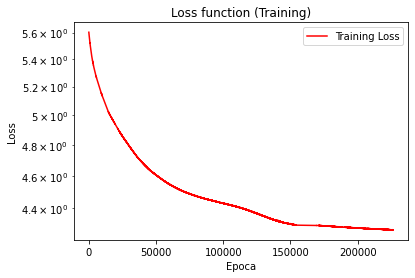

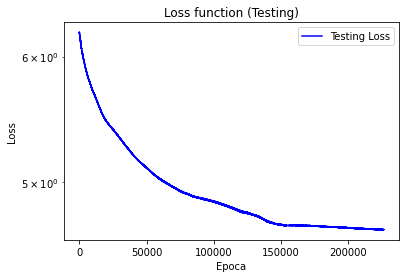

In [ ]:
modello_sperimentale.allena(learning_rate=5*1e-4,momentum=.9,epochs=10000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[16, 16, 1], 'SiLU'] \\
Errore medio (training set) & 4.27cm \\
Errori maggiori di 5cm (training set) & 32.33\% dei casi\\
Errori maggiori di 10cm (training set) & 9.66\% dei casi\\
Errore relativo medio (training set) & 3.41\% \\
Errori relativi maggiori del 10\% (training set) & 6.66\% dei casi \\
Errore medio a 50cm (training set): & 1.789cm (3.579\%)\\
Errore medio a 80cm (training set): & 3.037cm (3.797\%)\\
Errore medio a 100cm (training set): & 7.958cm (7.958\%)\\
Errore medio a 120cm (training set): & 5.301cm (4.417\%)\\
Errore medio a 150cm (training set): & 4.885cm (3.256\%)\\
Errore medio a 170cm (training set): & 2.121cm (1.248\%)\\
Errore medio a 200cm (training set): & 4.264cm (2.132\%)\\
Errore medio a 220cm (training set): & 5.496cm (2.498\%)\\
Errore medio a 250cm (training set): & 3.313cm (1.325\%)\\
Errore medio (testing set) & 4.67cm \\
Errori maggiori di 5cm (testing set) & 33.63\% dei casi\\
Errori maggiori di 10cm (t

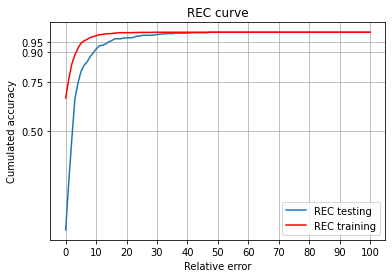

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###1HL 32HU


In [ ]:
modello_sperimentale=distanzinator(architecture=[16,32,1])

Epoch  1 / 100 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.579227924346924 	 Testing Loss:  5.087737560272217
Epoch  2 / 100 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.57921838760376 	 Testing Loss:  5.087917804718018
Epoch  3 / 100 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.579221248626709 	 Testing Loss:  5.087335586547852
Epoch  4 / 100 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.579244136810303 	 Testing Loss:  5.087912559509277
Epoch  5 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.019 	 Training Loss:  4.579230785369873 	 Testing Loss:  5.0871405601501465
Epoch  6 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.016 	 Training Loss:  4.579226016998291 	 Testing Loss:  5.086947917938232
Epoch  7 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.013 	 Training Loss:  4.579236030578613 	 Testing Loss:  5.088013172149658
Epoch  8 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.012 	 Training Loss:  4.579285621643066 	 Testing Loss:  5.08702230

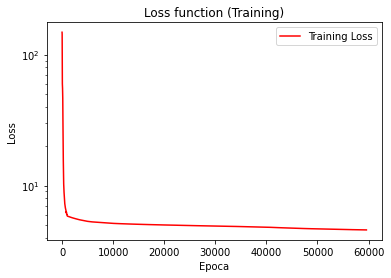

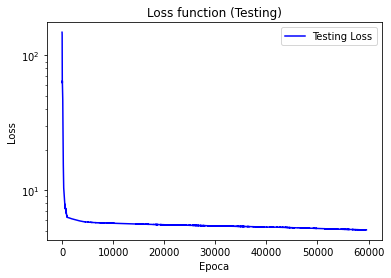

In [ ]:
modello_sperimentale.allena(learning_rate=1e-3,momentum=.9,epochs=100,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[16, 32, 1], 'SiLU'] \\
Errore medio (training set) & 4.58cm \\
Errori maggiori di 5cm (training set) & 34.67\% dei casi\\
Errori maggiori di 10cm (training set) & 12.07\% dei casi\\
Errore relativo medio (training set) & 3.68\% \\
Errori relativi maggiori del 10\% (training set) & 7.9\% dei casi \\
Errore medio a 50cm (training set): & 1.931cm (3.862\%)\\
Errore medio a 80cm (training set): & 3.849cm (4.811\%)\\
Errore medio a 100cm (training set): & 8.447cm (8.447\%)\\
Errore medio a 120cm (training set): & 5.201cm (4.335\%)\\
Errore medio a 150cm (training set): & 5.274cm (3.516\%)\\
Errore medio a 170cm (training set): & 2.24cm (1.318\%)\\
Errore medio a 200cm (training set): & 4.903cm (2.452\%)\\
Errore medio a 220cm (training set): & 5.335cm (2.425\%)\\
Errore medio a 250cm (training set): & 3.785cm (1.514\%)\\
Errore medio (testing set) & 5.09cm \\
Errori maggiori di 5cm (testing set) & 38.24\% dei casi\\
Errori maggiori di 10cm (te

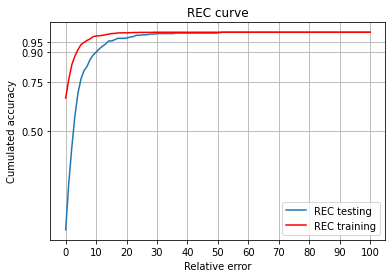

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 2
due hidden layer [4,4] hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[16,4,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  1 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.5749616622924805 	 Testing Loss:  6.057645320892334
Epoch  2 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.57501745223999 	 Testing Loss:  6.059656143188477
Epoch  3 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.575410842895508 	 Testing Loss:  6.056358337402344
Epoch  4 / 5000 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.575535774230957 	 Testing Loss:  6.058516979217529
Epoch  5 / 5000 	   Tempo trascorso:  0.001 	 Eta:  0.999 	 Training Loss:  5.575007915496826 	 Testing Loss:  6.059523105621338
Epoch  6 / 5000 	   Tempo trascorso:  0.001 	 Eta:  0.833 	 Training Loss:  5.575186252593994 	 Testing Loss:  6.056014537811279
Epoch  7 / 5000 	   Tempo trascorso:  0.001 	 Eta:  0.713 	 Training Loss:  5.575816631317139 	 Testing Loss:  6.058279991149902
Epoch  8 / 5000 	   Tempo trascorso:  0.001 	 Eta:  0.624 	 Tr

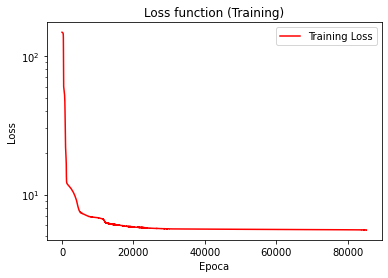

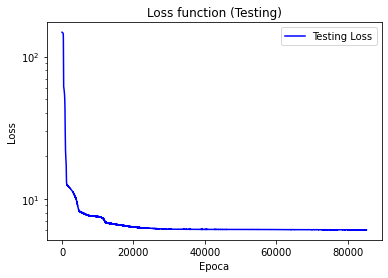

In [ ]:
modello_sperimentale.allena(learning_rate=2*1e-4,momentum=.9,epochs=5000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[16, 4, 4, 1], 'SiLU'] \\
Errore medio (training set) & 5.56cm \\
Errori maggiori di 5cm (training set) & 42.72\% dei casi\\
Errori maggiori di 10cm (training set) & 16.61\% dei casi\\
Errore relativo medio (training set) & 4.25\% \\
Errori relativi maggiori del 10\% (training set) & 8.49\% dei casi \\
Errore medio a 50cm (training set): & 1.963cm (2.453\%)\\
Errore medio a 80cm (training set): & 4.14cm (5.175\%)\\
Errore medio a 100cm (training set): & 9.091cm (11.364\%)\\
Errore medio a 120cm (training set): & 5.626cm (7.033\%)\\
Errore medio a 150cm (training set): & 6.124cm (7.655\%)\\
Errore medio a 170cm (training set): & 4.207cm (5.259\%)\\
Errore medio a 200cm (training set): & 5.536cm (6.92\%)\\
Errore medio a 220cm (training set): & 6.901cm (8.626\%)\\
Errore medio a 250cm (training set): & 6.308cm (7.885\%)\\
Errore medio (testing set) & 6.05cm \\
Errori maggiori di 5cm (testing set) & 46.15\% dei casi\\
Errori maggiori di 10cm 

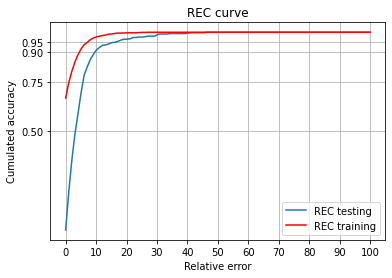

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 3
DUE HIDDEN LAYER CON [8,4] HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[16,8,4,1])

Epoch  1 / 100 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.525666236877441 	 Testing Loss:  5.016469955444336
Epoch  2 / 100 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.537999629974365 	 Testing Loss:  4.994340896606445
Epoch  3 / 100 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  4.525874614715576 	 Testing Loss:  4.972200393676758
Epoch  4 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.024 	 Training Loss:  4.540053844451904 	 Testing Loss:  4.97712516784668
Epoch  5 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.019 	 Training Loss:  4.532361030578613 	 Testing Loss:  5.012065887451172
Epoch  6 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.016 	 Training Loss:  4.53695011138916 	 Testing Loss:  5.003996849060059
Epoch  7 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.013 	 Training Loss:  4.532401084899902 	 Testing Loss:  4.972270965576172
Epoch  8 / 100 	   Tempo trascorso:  0.001 	 Eta:  0.012 	 Training Loss:  4.536703586578369 	 Testing Loss:  4.971820

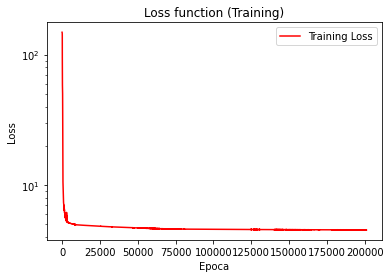

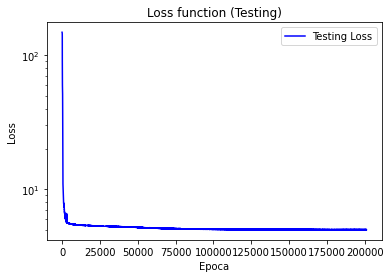

In [ ]:
modello_sperimentale.allena(learning_rate=1e-4,momentum=.9,epochs=100,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[16, 8, 4, 1], 'SiLU'] \\
Errore medio (training set) & 4.53cm \\
Errori maggiori di 5cm (training set) & 35.55\% dei casi\\
Errori maggiori di 10cm (training set) & 11.34\% dei casi\\
Errore relativo medio (training set) & 3.62\% \\
Errori relativi maggiori del 10\% (training set) & 6.95\% dei casi \\
Errore medio a 50cm (training set): & 1.87cm (2.337\%)\\
Errore medio a 80cm (training set): & 3.783cm (4.729\%)\\
Errore medio a 100cm (training set): & 8.374cm (10.467\%)\\
Errore medio a 120cm (training set): & 4.772cm (5.965\%)\\
Errore medio a 150cm (training set): & 5.629cm (7.036\%)\\
Errore medio a 170cm (training set): & 2.36cm (2.951\%)\\
Errore medio a 200cm (training set): & 4.571cm (5.713\%)\\
Errore medio a 220cm (training set): & 5.349cm (6.687\%)\\
Errore medio a 250cm (training set): & 3.792cm (4.74\%)\\
Errore medio (testing set) & 4.99cm \\
Errori maggiori di 5cm (testing set) & 37.36\% dei casi\\
Errori maggiori di 10cm (

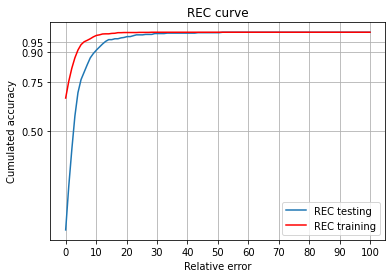

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 4
DUE HIDDEN LAYERS CON [16,4] HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[16,16,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  5001 / 10000 	   Tempo trascorso:  0.666 	 Eta:  0.666 	 Training Loss:  4.759196758270264 	 Testing Loss:  5.130880355834961
Epoch  5002 / 10000 	   Tempo trascorso:  0.666 	 Eta:  0.666 	 Training Loss:  4.759271621704102 	 Testing Loss:  5.131473064422607
Epoch  5003 / 10000 	   Tempo trascorso:  0.666 	 Eta:  0.665 	 Training Loss:  4.759195327758789 	 Testing Loss:  5.131801128387451
Epoch  5004 / 10000 	   Tempo trascorso:  0.666 	 Eta:  0.665 	 Training Loss:  4.75924825668335 	 Testing Loss:  5.13128662109375
Epoch  5005 / 10000 	   Tempo trascorso:  0.667 	 Eta:  0.666 	 Training Loss:  4.7591938972473145 	 Testing Loss:  5.130990505218506
Epoch  5006 / 10000 	   Tempo trascorso:  0.667 	 Eta:  0.666 	 Training Loss:  4.759228229522705 	 Testing Loss:  5.131324768066406
Epoch  5007 / 10000 	   Tempo trascorso:  0.667 	 Eta:  0.665 	 Training Loss:  4.759178638458252 	 Testing Loss:  5.131793975830078
Epoch  5008 / 10000

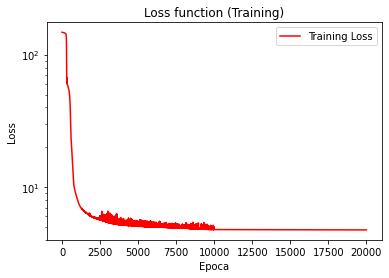

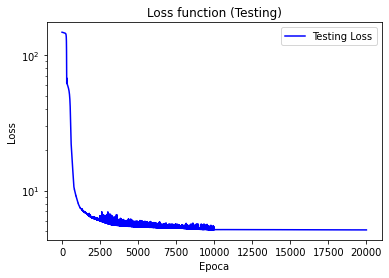

In [ ]:
modello_sperimentale.allena(learning_rate=1e-4,momentum=.9,epochs=10000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

Statistiche sul training set:\\
Errore medio:  4.75 cm\\
Errore maggiore di 5 cm in 493/1367 casi(36.06\%)\\
Errore maggiore di 10 cm in 168/1367 casi(12.29\%)\\
Errore relativo medio: 3.86\%)\\
Errore relativo maggiore del 10% in 116/1367 casi (8.49 \%)\\
Errore medio a 50 cm:	 2.632	 cm (3.29\%)\\
Errore medio a 80 cm:	 3.693	 cm (4.616\%)\\
Errore medio a 100 cm:	 8.002	 cm (10.002\%)\\
Errore medio a 120 cm:	 5.254	 cm (6.568\%)\\
Errore medio a 150 cm:	 6.28	 cm (7.85\%)\\
Errore medio a 170 cm:	 2.443	 cm (3.054\%)\\
Errore medio a 200 cm:	 4.754	 cm (5.942\%)\\
Errore medio a 220 cm:	 5.172	 cm (6.465\%)\\
Errore medio a 250 cm:	 4.222	 cm (5.277\%)\\
Statistiche sul testing set:\\
Errore medio:  5.12 cm\\
Errore maggiore di 5 cm in 175/455 casi(38.46\%)\\
Errore maggiore di 10 cm in 62/455 casi(13.63\%)\\
Errore relativo medio: 4.34\%)\\
Errore relativo maggiore del 10% in 48/455 casi (10.55 \%)\\
Errore medio a 50 cm:	 3.829	 cm (4.787\%)\\
Errore medio a 80 cm:	 3.951	 cm (4.

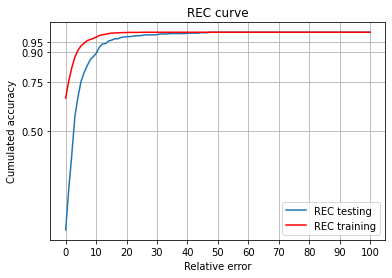

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

##8 PUNTI + AREA

###CARICO IL DATASET

In [ ]:
pos=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
dataset_x=[]
for elemento in preprocessed_dataset_x:
  temp=torch.Tensor([elemento[y] for y in pos])
  dataset_x.append(torch.reshape(temp,(-1,)))

dataset_x=torch.stack(dataset_x)
dataset_y=preprocessed_dataset_y

#Shuffle the dataset
dataset_x, dataset_y = shuffle(dataset_x, dataset_y, random_state=seed_randoom)

dataset_size=len(dataset_x)

testing_size=int(dataset_size/4.)

#Separo in training e testing
training_x=dataset_x[testing_size:]
training_y=dataset_y[testing_size:]
testing_x=dataset_x[:testing_size]
testing_y=dataset_y[:testing_size]

###ESPERIMENTO 1
un hidden layer 4 hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[17,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  115001 / 120000 	   Tempo trascorso:  14.587 	 Eta:  0.634 	 Training Loss:  6.853916168212891 	 Testing Loss:  7.423102378845215
Epoch  115002 / 120000 	   Tempo trascorso:  14.587 	 Eta:  0.634 	 Training Loss:  6.8542327880859375 	 Testing Loss:  7.426363468170166
Epoch  115003 / 120000 	   Tempo trascorso:  14.587 	 Eta:  0.634 	 Training Loss:  6.853911399841309 	 Testing Loss:  7.426985263824463
Epoch  115004 / 120000 	   Tempo trascorso:  14.587 	 Eta:  0.634 	 Training Loss:  6.854022979736328 	 Testing Loss:  7.4231109619140625
Epoch  115005 / 120000 	   Tempo trascorso:  14.588 	 Eta:  0.634 	 Training Loss:  6.854226589202881 	 Testing Loss:  7.427637577056885
Epoch  115006 / 120000 	   Tempo trascorso:  14.588 	 Eta:  0.634 	 Training Loss:  6.854161262512207 	 Testing Loss:  7.426538944244385
Epoch  115007 / 120000 	   Tempo trascorso:  14.588 	 Eta:  0.633 	 Training Loss:  6.853909969329834 	 Testing Loss:  7.4228

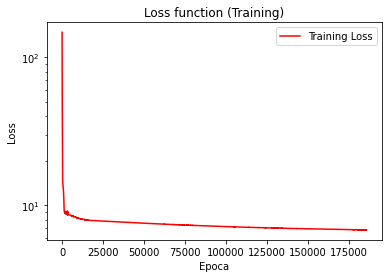

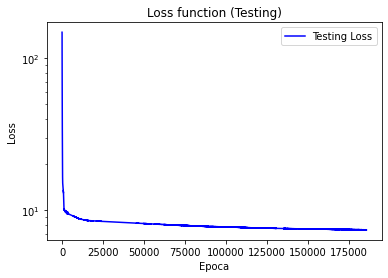

In [ ]:
modello_sperimentale.allena(learning_rate=1e-3,momentum=.9,epochs=120000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[17, 4, 1], 'SiLU'] \\
Errore medio (training set) & 6.84cm \\
Errori maggiori di 5cm (training set) & 52.08\% dei casi\\
Errori maggiori di 10cm (training set) & 24.58\% dei casi\\
Errore relativo medio (training set) & 5.59\% \\
Errori relativi maggiori del 10\% (training set) & 14.12\% dei casi \\
Errore medio a 50cm (training set): & 6.045cm (7.556\%)\\
Errore medio a 80cm (training set): & 3.492cm (4.364\%)\\
Errore medio a 100cm (training set): & 8.265cm (10.331\%)\\
Errore medio a 120cm (training set): & 7.27cm (9.088\%)\\
Errore medio a 150cm (training set): & 8.193cm (10.242\%)\\
Errore medio a 170cm (training set): & 5.883cm (7.354\%)\\
Errore medio a 200cm (training set): & 6.257cm (7.821\%)\\
Errore medio a 220cm (training set): & 7.244cm (9.054\%)\\
Errore medio a 250cm (training set): & 8.609cm (10.761\%)\\
Errore medio (testing set) & 7.41cm \\
Errori maggiori di 5cm (testing set) & 54.29\% dei casi\\
Errori maggiori di 10cm

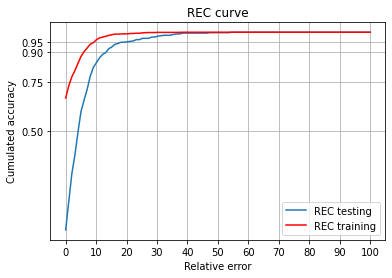

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 2
un hidden layer 8 hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[17,8,1])

Epoch  1 / 200 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.171324253082275 	 Testing Loss:  5.787810325622559
Epoch  2 / 200 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.171471118927002 	 Testing Loss:  5.786118984222412
Epoch  3 / 200 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.171617031097412 	 Testing Loss:  5.787631034851074
Epoch  4 / 200 	   Tempo trascorso:  0.0 	 Eta:  0.0 	 Training Loss:  5.171635627746582 	 Testing Loss:  5.786586284637451
Epoch  5 / 200 	   Tempo trascorso:  0.001 	 Eta:  0.039 	 Training Loss:  5.171326160430908 	 Testing Loss:  5.785832405090332
Epoch  6 / 200 	   Tempo trascorso:  0.001 	 Eta:  0.033 	 Training Loss:  5.171890735626221 	 Testing Loss:  5.788382053375244
Epoch  7 / 200 	   Tempo trascorso:  0.001 	 Eta:  0.028 	 Training Loss:  5.17178201675415 	 Testing Loss:  5.787813186645508
Epoch  8 / 200 	   Tempo trascorso:  0.001 	 Eta:  0.024 	 Training Loss:  5.171380043029785 	 Testing Loss:  5.786086559

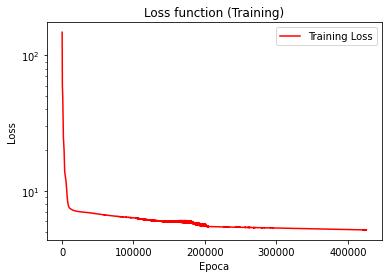

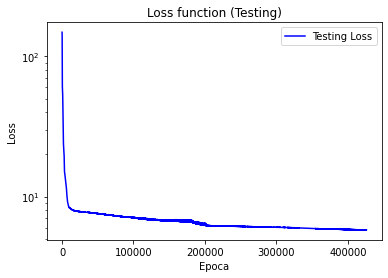

In [ ]:
modello_sperimentale.allena(learning_rate=5*1e-4,momentum=.9,epochs=200,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[17, 8, 1], 'SiLU'] \\
Errore medio (training set) & 5.17cm \\
Errori maggiori di 5cm (training set) & 40.23\% dei casi\\
Errori maggiori di 10cm (training set) & 14.56\% dei casi\\
Errore relativo medio (training set) & 3.98\% \\
Errori relativi maggiori del 10\% (training set) & 8.05\% dei casi \\
Errore medio a 50cm (training set): & 1.721cm (2.152\%)\\
Errore medio a 80cm (training set): & 4.149cm (5.187\%)\\
Errore medio a 100cm (training set): & 9.04cm (11.3\%)\\
Errore medio a 120cm (training set): & 4.552cm (5.689\%)\\
Errore medio a 150cm (training set): & 6.446cm (8.057\%)\\
Errore medio a 170cm (training set): & 3.189cm (3.986\%)\\
Errore medio a 200cm (training set): & 5.614cm (7.018\%)\\
Errore medio a 220cm (training set): & 6.444cm (8.055\%)\\
Errore medio a 250cm (training set): & 5.229cm (6.536\%)\\
Errore medio (testing set) & 5.79cm \\
Errori maggiori di 5cm (testing set) & 42.64\% dei casi\\
Errori maggiori di 10cm (tes

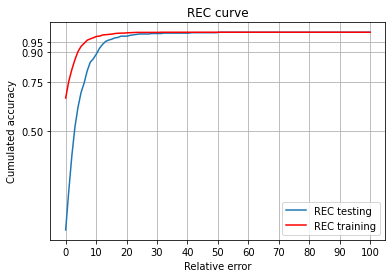

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 2B:
UN HIDDEN LAYER 16 HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[17,16,1])

Streaming output truncated to the last 5000 lines.
Epoch  95001 / 100000 	   Tempo trascorso:  11.665 	 Eta:  0.614 	 Training Loss:  4.647713661193848 	 Testing Loss:  5.2672905921936035
Epoch  95002 / 100000 	   Tempo trascorso:  11.665 	 Eta:  0.614 	 Training Loss:  4.646714687347412 	 Testing Loss:  5.263752460479736
Epoch  95003 / 100000 	   Tempo trascorso:  11.665 	 Eta:  0.614 	 Training Loss:  4.64700984954834 	 Testing Loss:  5.2645063400268555
Epoch  95004 / 100000 	   Tempo trascorso:  11.665 	 Eta:  0.614 	 Training Loss:  4.64619779586792 	 Testing Loss:  5.267061233520508
Epoch  95005 / 100000 	   Tempo trascorso:  11.665 	 Eta:  0.613 	 Training Loss:  4.6469831466674805 	 Testing Loss:  5.2650322914123535
Epoch  95006 / 100000 	   Tempo trascorso:  11.665 	 Eta:  0.613 	 Training Loss:  4.645949840545654 	 Testing Loss:  5.263406276702881
Epoch  95007 / 100000 	   Tempo trascorso:  11.665 	 Eta:  0.613 	 Training Loss:  4.6467742919921875 	 Testing Loss:  5.2665019035

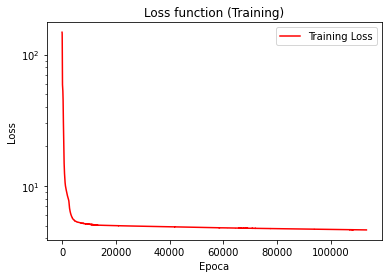

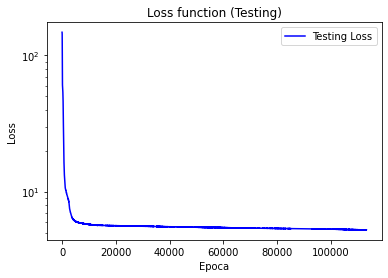

In [ ]:
modello_sperimentale.allena(learning_rate=1e-3,momentum=.9,epochs=100000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[17, 16, 1], 'SiLU'] \\
Errore medio (training set) & 4.63cm \\
Errori maggiori di 5cm (training set) & 35.77\% dei casi\\
Errori maggiori di 10cm (training set) & 11.7\% dei casi\\
Errore relativo medio (training set) & 3.76\% \\
Errori relativi maggiori del 10\% (training set) & 8.19\% dei casi \\
Errore medio a 50cm (training set): & 1.63cm (3.26\%)\\
Errore medio a 80cm (training set): & 4.784cm (5.98\%)\\
Errore medio a 100cm (training set): & 9.375cm (9.375\%)\\
Errore medio a 120cm (training set): & 4.248cm (3.54\%)\\
Errore medio a 150cm (training set): & 5.662cm (3.775\%)\\
Errore medio a 170cm (training set): & 2.191cm (1.289\%)\\
Errore medio a 200cm (training set): & 5.217cm (2.609\%)\\
Errore medio a 220cm (training set): & 5.027cm (2.285\%)\\
Errore medio a 250cm (training set): & 3.347cm (1.339\%)\\
Errore medio (testing set) & 5.24cm \\
Errori maggiori di 5cm (testing set) & 40.88\% dei casi\\
Errori maggiori di 10cm (testi

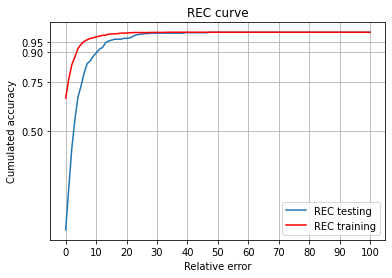

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 3:
due hidden layer [4,4] hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[17,4,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  5001 / 10000 	   Tempo trascorso:  0.479 	 Eta:  0.479 	 Training Loss:  6.702112197875977 	 Testing Loss:  7.0922441482543945
Epoch  5002 / 10000 	   Tempo trascorso:  0.479 	 Eta:  0.479 	 Training Loss:  6.70207405090332 	 Testing Loss:  7.0920796394348145
Epoch  5003 / 10000 	   Tempo trascorso:  0.479 	 Eta:  0.479 	 Training Loss:  6.702059745788574 	 Testing Loss:  7.092161178588867
Epoch  5004 / 10000 	   Tempo trascorso:  0.479 	 Eta:  0.478 	 Training Loss:  6.702040672302246 	 Testing Loss:  7.092247009277344
Epoch  5005 / 10000 	   Tempo trascorso:  0.479 	 Eta:  0.478 	 Training Loss:  6.702031135559082 	 Testing Loss:  7.091766357421875
Epoch  5006 / 10000 	   Tempo trascorso:  0.479 	 Eta:  0.478 	 Training Loss:  6.7020263671875 	 Testing Loss:  7.09177827835083
Epoch  5007 / 10000 	   Tempo trascorso:  0.48 	 Eta:  0.479 	 Training Loss:  6.702003479003906 	 Testing Loss:  7.092235088348389
Epoch  5008 / 10000 	

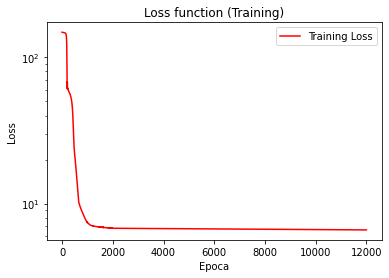

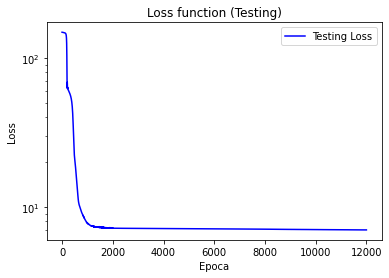

In [ ]:
modello_sperimentale.allena(learning_rate=1e-4,momentum=.9,epochs=10000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

Errore medio:  7.0 cm\\
Errore maggiore di 5 cm in 237/455 casi(52.09\%)\\
Errore maggiore di 10 cm in 113/455 casi(24.84\%)\\
Errore relativo medio: 6.05\%)\\
Errore relativo maggiore del 10% in 62/455 casi (13.63 \%)\\
Errore medio a 50 cm:	 8.436	 cm (10.544\%)\\
Errore medio a 80 cm:	 2.81	 cm (3.512\%)\\
Errore medio a 100 cm:	 9.213	 cm (11.516\%)\\
Errore medio a 120 cm:	 6.846	 cm (8.558\%)\\
Errore medio a 150 cm:	 7.539	 cm (9.423\%)\\
Errore medio a 170 cm:	 7.222	 cm (9.027\%)\\
Errore medio a 200 cm:	 8.098	 cm (10.122\%)\\
Errore medio a 220 cm:	 5.801	 cm (7.251\%)\\
Errore medio a 250 cm:	 7.613	 cm (9.517\%)\\


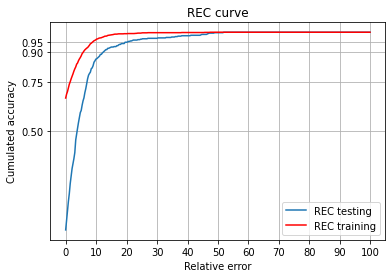

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 4:
due hidden layers [8,4] hidden units

In [ ]:
modello_sperimentale=distanzinator(architecture=[17,8,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  95001 / 100000 	   Tempo trascorso:  12.768 	 Eta:  0.672 	 Training Loss:  4.716213226318359 	 Testing Loss:  5.193176746368408
Epoch  95002 / 100000 	   Tempo trascorso:  12.768 	 Eta:  0.672 	 Training Loss:  4.716211795806885 	 Testing Loss:  5.193051338195801
Epoch  95003 / 100000 	   Tempo trascorso:  12.769 	 Eta:  0.672 	 Training Loss:  4.716220855712891 	 Testing Loss:  5.193032264709473
Epoch  95004 / 100000 	   Tempo trascorso:  12.769 	 Eta:  0.672 	 Training Loss:  4.716222286224365 	 Testing Loss:  5.193174362182617
Epoch  95005 / 100000 	   Tempo trascorso:  12.769 	 Eta:  0.671 	 Training Loss:  4.71621036529541 	 Testing Loss:  5.19301700592041
Epoch  95006 / 100000 	   Tempo trascorso:  12.769 	 Eta:  0.671 	 Training Loss:  4.716202735900879 	 Testing Loss:  5.192883014678955
Epoch  95007 / 100000 	   Tempo trascorso:  12.769 	 Eta:  0.671 	 Training Loss:  4.716207981109619 	 Testing Loss:  5.193080425262451

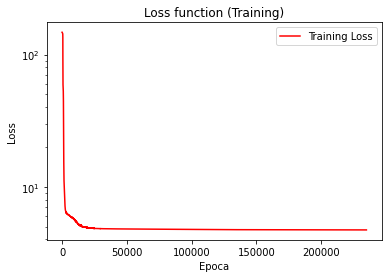

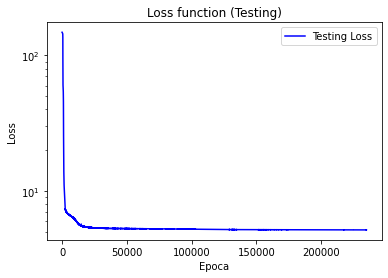

In [ ]:
modello_sperimentale.allena(learning_rate=1e-5,momentum=.9,epochs=100000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

\begin{table}[]
\begin{tabular}{ll}
Modello & [[17, 8, 4, 1], 'SiLU'] \\
Errore medio (training set) & 4.72cm \\
Errori maggiori di 5cm (training set) & 36.36\% dei casi\\
Errori maggiori di 10cm (training set) & 12.07\% dei casi\\
Errore relativo medio (training set) & 3.75\% \\
Errori relativi maggiori del 10\% (training set) & 7.9\% dei casi \\
Errore medio a 50cm (training set): & 1.895cm (2.369\%)\\
Errore medio a 80cm (training set): & 4.002cm (5.002\%)\\
Errore medio a 100cm (training set): & 8.51cm (10.638\%)\\
Errore medio a 120cm (training set): & 5.081cm (6.351\%)\\
Errore medio a 150cm (training set): & 5.449cm (6.811\%)\\
Errore medio a 170cm (training set): & 2.492cm (3.115\%)\\
Errore medio a 200cm (training set): & 4.565cm (5.707\%)\\
Errore medio a 220cm (training set): & 5.702cm (7.127\%)\\
Errore medio a 250cm (training set): & 4.511cm (5.639\%)\\
Errore medio (testing set) & 5.19cm \\
Errori maggiori di 5cm (testing set) & 39.34\% dei casi\\
Errori maggiori di 10cm 

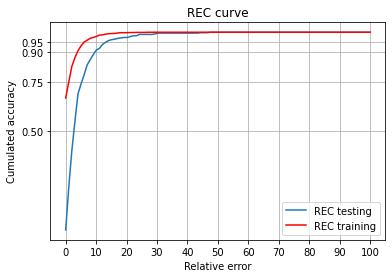

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

###ESPERIMENTO 5
DUE HIDDEN LAYERS [16,4] HIDDEN UNITS

In [ ]:
modello_sperimentale=distanzinator(architecture=[17,16,4,1])

Streaming output truncated to the last 5000 lines.
Epoch  45001 / 50000 	   Tempo trascorso:  5.957 	 Eta:  0.662 	 Training Loss:  5.066247463226318 	 Testing Loss:  5.467222213745117
Epoch  45002 / 50000 	   Tempo trascorso:  5.957 	 Eta:  0.662 	 Training Loss:  5.066246032714844 	 Testing Loss:  5.467296123504639
Epoch  45003 / 50000 	   Tempo trascorso:  5.958 	 Eta:  0.662 	 Training Loss:  5.066246032714844 	 Testing Loss:  5.4672675132751465
Epoch  45004 / 50000 	   Tempo trascorso:  5.958 	 Eta:  0.662 	 Training Loss:  5.066242218017578 	 Testing Loss:  5.467222213745117
Epoch  45005 / 50000 	   Tempo trascorso:  5.958 	 Eta:  0.661 	 Training Loss:  5.066242694854736 	 Testing Loss:  5.467297077178955
Epoch  45006 / 50000 	   Tempo trascorso:  5.958 	 Eta:  0.661 	 Training Loss:  5.066240310668945 	 Testing Loss:  5.4672369956970215
Epoch  45007 / 50000 	   Tempo trascorso:  5.958 	 Eta:  0.661 	 Training Loss:  5.066235542297363 	 Testing Loss:  5.467230319976807
Epoch  45

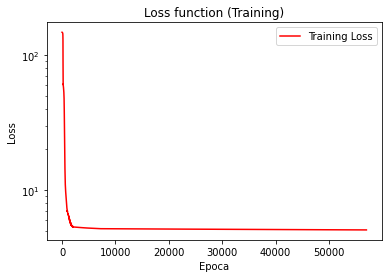

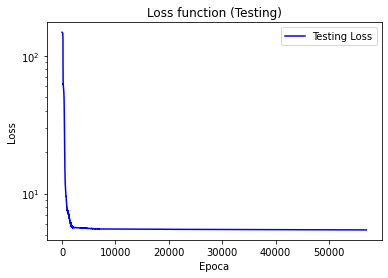

In [ ]:
modello_sperimentale.allena(learning_rate=1e-5,momentum=.9,epochs=50000,training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

Statistiche sul training set:\\
Errore medio:  5.06 cm\\
Errore maggiore di 5 cm in 508/1367 casi(37.16\%)\\
Errore maggiore di 10 cm in 192/1367 casi(14.05\%)\\
Errore relativo medio: 4.16\%)\\
Errore relativo maggiore del 10% in 121/1367 casi (8.85 \%)\\
Errore medio a 50 cm:	 3.314	 cm (4.142\%)\\
Errore medio a 80 cm:	 3.805	 cm (4.756\%)\\
Errore medio a 100 cm:	 8.372	 cm (10.465\%)\\
Errore medio a 120 cm:	 5.248	 cm (6.56\%)\\
Errore medio a 150 cm:	 5.933	 cm (7.417\%)\\
Errore medio a 170 cm:	 3.143	 cm (3.929\%)\\
Errore medio a 200 cm:	 5.059	 cm (6.324\%)\\
Errore medio a 220 cm:	 5.382	 cm (6.728\%)\\
Errore medio a 250 cm:	 4.988	 cm (6.235\%)\\
Statistiche sul testing set:\\
Errore medio:  5.46 cm\\
Errore maggiore di 5 cm in 182/455 casi(40.0\%)\\
Errore maggiore di 10 cm in 70/455 casi(15.38\%)\\
Errore relativo medio: 4.58\%)\\
Errore relativo maggiore del 10% in 48/455 casi (10.55 \%)\\
Errore medio a 50 cm:	 4.327	 cm (5.409\%)\\
Errore medio a 80 cm:	 3.449	 cm (4

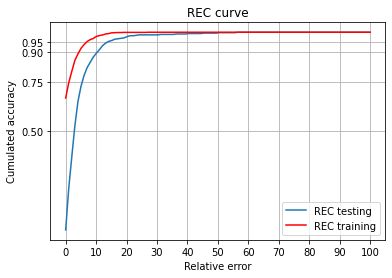

In [ ]:
modello_sperimentale.valuta(training_x=training_x,training_y=training_y,testing_x=testing_x,testing_y=testing_y)

##LANCIARE QUESTO PER SALVARE IL MODELLO SPERIMENTALE

In [ ]:
modello_sperimentale.clean_losses()
torch.save(modello_sperimentale,'drive/MyDrive/MLProject_final/modello'+str(modello_sperimentale.model_data)+'.pt')

#DEMO

##Questa prima cella serve a caricare i modelli salvati, a definire i metadata per l'object detectio e a settare la treshold del predictor

In [ ]:
#CARICO I MODELLI DI DETECTRON2 E DEL DISTANZINATOR

#QUI DICO DOVE LI TROVA
distanzinator_model_path='drive/MyDrive/MLProject_final/Modelli_Distanzinator/modello[[16, 16, 1], \'SiLU\'].pt'
#distanzinator_model_path='drive/MyDrive/MLProject_final/Modelli_Distanzinator/modello[[16, 8, 4, 1], \'SiLU\'].pt'
detectron2_model_dir='drive/MyDrive/MLProject_final/detector2_training_output'

#CARICO IL DISTANZINATOR
modello_distanzinator=torch.load(distanzinator_model_path)

#DEFINISCO I METADATA PER DETECTRON2 COSÌ NON HO BISOGNO DI CARICARLI DAL DATASET
metadata_poor = Metadata()
metadata_poor.set(thing_classes = ['HighVoltageSign'])

#CARICO IL PREDICTOR
cfg = get_cfg()
cfg.MODEL.DEVICE=device

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = os.path.join(detectron2_model_dir, "model_final.pth")
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

#QUI CHIEDO LA TRESHOLD DEL PREDICTOR
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85

predictor = DefaultPredictor(cfg)

##Questa cella mostra come si usa il programma finito
È sufficiente indicare il path dell'immagine

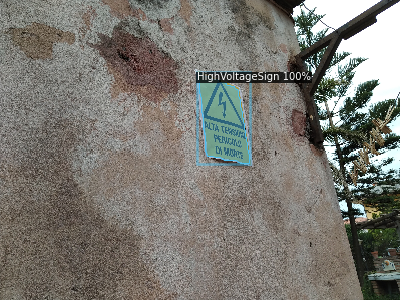

Il cartello dista  [111.55551147460938] cm


In [ ]:
#Path dell'immagine da analizzare
image_path='drive/MyDrive/MLProject_final/Demo/fotodemo1_100cm.jpg'

distanza=modello_distanzinator.image_to_distance(image_path,predictor_model=predictor,print_output='y')
if distanza==[]:
  print('Non sono stati trovati cartelli in questa foto.')
elif len(distanza)==1:
  print('Il cartello dista ',distanza,'cm')
else:
  print('I cartelli distano ',distanza,'cm')

##Questa cella mostra il funzionamento del programma su alcune foto preselezionate
Nell'ultima foto il predictor trova dei falsi positivi, ma dà in output la distanza di ogni instanza riconosciuta come cartello, quindi anche quella giusta.
Ovviamente la distanza degli oggetti che non sono il cartello ma sono stati riconosciuti come tali è sbagliata ma questo importa poco...

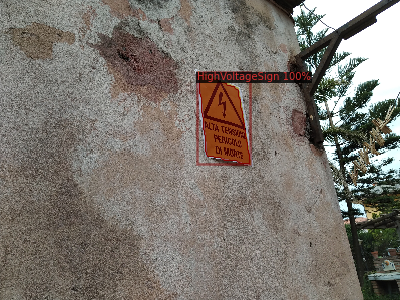

fotodemo1_100cm.jpg
Il cartello dista  [111.55551147460938] cm


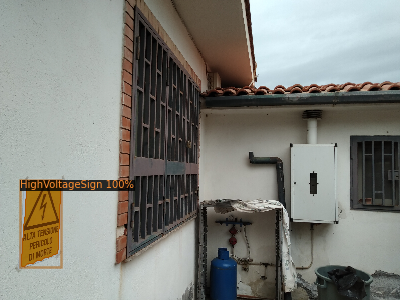

fotodemo4_100.jpg
Il cartello dista  [122.9210205078125] cm


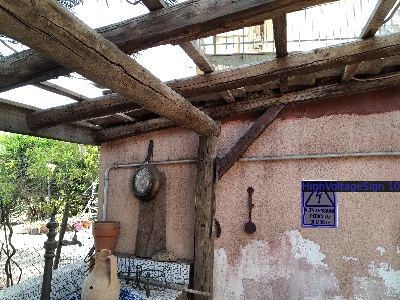

fotodemo2_220cm.jpg
Il cartello dista  [229.2896728515625] cm


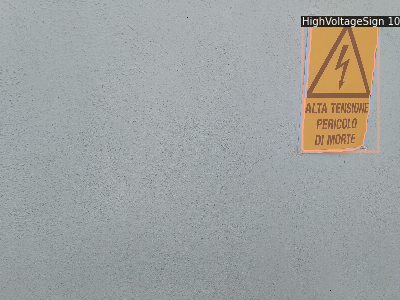

fotodemo3_80cm.jpg
Il cartello dista  [78.66270446777344] cm


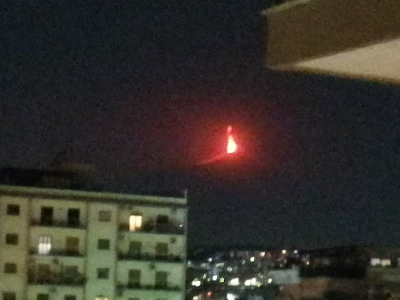

IMG_20210522_231725.jpg
Non sono stati trovati cartelli in questa foto.


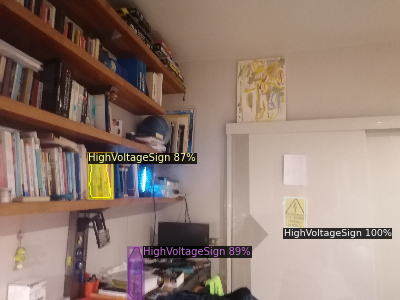

IMG_20210530_230053.jpg
I cartelli distano  [296.3454284667969, 201.63768005371094, 241.9510498046875] cm


In [ ]:
directory_demo='drive/MyDrive/MLProject_final/Demo'
for filename in os.listdir(directory_demo):
  if filename.endswith(".jpg"):
    image_path=directory_demo+'/'+filename
    distanza=modello_distanzinator.image_to_distance(image_path,predictor_model=predictor,print_output='y')
    print(filename)
    if distanza==[]:
      print('Non sono stati trovati cartelli in questa foto.')
    elif len(distanza)==1:
      print('Il cartello dista ',distanza,'cm')
    else:
      print('I cartelli distano ',distanza,'cm')